# Comp1-传统组学

主要适配于传统组学的建模和刻画。典型的应用场景探究rad_score最最终临床诊断的作用。

数据的一般形式为(具体文件,文件夹名可以不同)：
1. `images`文件夹，存放研究对象所有的CT、MRI等数据。
2. `masks`文件夹, 存放手工（Manuelly）勾画的ROI区域。与images文件夹的文件意义对应。
3. `label.txt`文件，每个患者对应的标签，例如肿瘤的良恶性、5年存活状态等。

## Onekey步骤

1. 数据校验，检查数据格式是否正确。
2. 组学特征提取，如果第一步检查数据通过，则提取对应数据的特征。
3. 读取标注数据信息。
4. 特征与标注数据拼接。形成数据集。
5. 查看一些统计信息，检查数据时候存在异常点。
6. 正则化，将数据变化到服从 N~(0, 1)。
7. 通过相关系数，例如spearman、person等筛选出特征。
8. 构建训练集和测试集，这里使用的是随机划分，正常多中心验证，需要大家根据自己的场景构建两份数据。
9. 通过Lasso筛选特征，选取其中的非0项作为后续模型的特征。
10. 使用机器学习算法，例如LR、SVM、RF等进行任务学习。
11. 模型结果可视化，例如AUC、ROC曲线，混淆矩阵等。


## 一、数据校验
首先需要检查诊断数据，如果显示`检查通过！`择可以正常运行之后的，否则请根据提示调整数据。

**注意**：这里要求images和masks文件夹中的文件名必须一一对应。e.g. `1.nii.gz`为images中的一个文件，在masks文件夹必须也存在一个`1.nii.gz`文件。

当然也可以使用自定义的函数，获取解析数据。

### 指定数据

此模块有3个需要自己定义的参数

1. `mydir`: 数据存放的路径。
2. `labelf`: 每个样本的标注信息文件。
3. `labels`: 要让AI系统学习的目标，例如肿瘤的良恶性、T-stage等。

In [1]:
import os
from IPython.display import display
os.environ['KMP_DUPLICATE_LIB_OK'] = 'TRUE'
from onekey_algo import OnekeyDS as okds
from onekey_algo import get_param_in_cwd

os.makedirs('img', exist_ok=True)
os.makedirs('results', exist_ok=True)

task_type = 'DLR_'
# 设置数据目录
# mydir = r'你自己数据的路径'
mydir = get_param_in_cwd('radio_dir')
# 对应的标签文件
group_info = get_param_in_cwd('dataset_column') or 'group'
labelf = get_param_in_cwd('label_file') or os.path.join(mydir, 'label.csv')
# 读取标签数据列名
labels = [get_param_in_cwd('task_column') or 'label']

### images和masks匹配

这里要求images和masks文件夹中的文件名必须一一对应。e.g. `1.nii.gz`为images中的一个文件，在masks文件夹必须也存在一个`1.nii.gz`文件。

当然也可以使用自定义的函数，获取解析数据。

In [2]:
from pathlib import Path
from onekey_algo.custom.components.Radiology import diagnose_3d_image_mask_settings, get_image_mask_from_dir
from onekey_algo import get_param_in_cwd

# 传统组学特征

使用pyradiomics提取传统组学特征，正常这块不需要修改，下面是具体的Onekey封装的接口。

```python
def extract(self, images: Union[str, List[str]], 
            masks: Union[str, List[str]], labels: Union[int, List[int]] = 1, settings=None)
"""
    * images: List结构，待提取的图像列表。
    * masks: List结构，待提取的图像对应的mask，与Images必须一一对应。
    * labels: 提取标注为什么标签的特征。默认为提取label=1的。
    * settings: 其他提取特征的参数。默认为None。

"""
```

```python
def get_label_data_frame(self, label: int = 1, column_names=None, images='images', masks='labels')
"""
    * label: 获取对应label的特征。
    * columns_names: 默认为None，使用程序设定的列名即可。
"""
```
    
```python
def get_image_mask_from_dir(root, images='images', masks='labels')
"""
    * root: 待提取特征的目录。
    * images: root目录中原始数据的文件夹名。
    * masks: root目录中标注数据的文件夹名。
"""
```


In [3]:
import warnings
import pandas as pd
import os
warnings.filterwarnings("ignore")
from onekey_algo.custom.components.Radiology import ConventionalRadiomics

# 瘤内Mask ID
intra_mask_id = get_param_in_cwd('intra_mask_id') or 1
# 瘤周Mask ID
peri_mask_id = get_param_in_cwd('peri_mask_id') or 2

rad_data = []

rad_data = None
for mask_id, m in enumerate(['']):
    prefix = 'intra' if m == '' else task_type.strip('_')
    if os.path.exists(f'features/rad_features_{prefix}.csv'):
        rad_data_ = pd.read_csv(f'features/rad_features_{prefix}.csv', header=0)
    else:
        images, masks = get_image_mask_from_dir(mydir, images=f'images', masks=f'masks')
        # 如果要自定义一些特征提取方式，可以使用param_file。
        param_file = r'./custom_settings/exampleCT.yaml'
        # extractor_settings这个参数放的是参数配置文件的位置，默认为空。
        # param_file = get_param_in_cwd('extractor_settings')
        radiomics = ConventionalRadiomics(param_file, correctMask=True)
        radiomics.extract(images, masks, labels=mask_id+1, workers=4)
        rad_data_ = radiomics.get_label_data_frame(label=mask_id+1)
        rad_data_.columns = [f"{prefix}_{c.replace('-', '_')}" if c != 'ID' else c for c in rad_data_.columns]
        rad_data_.to_csv(f'features/rad_features_{prefix}.csv', header=True, index=False)
    if rad_data is None:
        rad_data = rad_data_
    else:
        rad_data = pd.merge(rad_data, rad_data_, on='ID', how='inner')
        
rad_data['ID'] = rad_data['ID'].map(lambda x: x.replace(' ', '').replace('（', '(').replace('）', ')'))
rad_data

,ID,intra_exponential_firstorder_10Percentile,intra_exponential_firstorder_90Percentile,intra_exponential_firstorder_Energy,intra_exponential_firstorder_Entropy,intra_exponential_firstorder_InterquartileRange,intra_exponential_firstorder_Kurtosis,intra_exponential_firstorder_Maximum,intra_exponential_firstorder_Mean,intra_exponential_firstorder_MeanAbsoluteDeviation,...,intra_wavelet_LLL_glszm_SmallAreaHighGrayLevelEmphasis,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZonePercentage,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength
0,1010.nii.gz,0.457,2.933,2.934e+08,2.055e-01,1.017,168.783,41.838,1.394,0.871,...,1604.108,2.444e-03,7.640,0.630,2.232,0.128,0.002,29171.708,0.358,13.208
1,1021.nii.gz,0.772,11.327,3.502e+07,1.373e+00,8.293,1.623,12.256,5.004,3.696,...,3038.059,3.464e-03,7.099,0.752,3.199,0.019,0.008,51645.571,2.040,45.373
2,1022.nii.gz,0.606,1.358,7.423e+07,1.228e-02,0.328,25.911,6.090,0.964,0.294,...,478.756,7.517e-03,6.974,0.537,3.418,0.105,0.007,8596.375,0.199,17.727
3,1025.nii.gz,0.980,8.920,1.391e+08,1.080e+00,5.107,2.142,13.074,4.056,2.635,...,2498.124,1.819e-03,7.457,0.691,2.979,0.055,0.004,31422.200,1.040,15.276
4,1030.nii.gz,0.643,2.913,9.789e+07,6.924e-02,0.984,5.590,5.344,1.454,0.751,...,1773.201,3.542e-03,7.357,0.726,0.809,0.072,0.005,31751.372,0.587,24.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
431,808.nii.gz,2.313,29.100,2.348e+08,2.783e+00,16.809,11.275,172.913,18.817,9.313,...,6510.129,6.011e-04,7.524,0.527,187.291,0.026,0.002,45920.987,0.541,18.875
432,840.nii.gz,0.683,1.451,5.306e+07,-3.203e-16,0.361,11.806,3.650,1.021,0.275,...,1268.156,3.222e-03,6.792,0.612,2.257,0.043,0.008,9038.016,0.223,16.002
433,858.nii.gz,0.732,1.642,5.391e+07,-3.203e-16,0.428,8.998,3.622,1.110,0.304,...,1124.952,2.570e-03,6.847,0.677,1.268,0.053,0.007,14510.973,0.337,18.680
434,9.nii.gz,0.602,1.588,8.980e+07,-3.203e-16,0.501,8.099,4.480,1.029,0.324,...,514.553,5.088e-03,6.932,0.577,2.588,0.145,0.005,6335.831,0.267,7.331


In [4]:
from onekey_algo.custom.utils import print_join_info

dl_features = pd.read_csv('features/compress_features.csv')
dl_features.columns = ['ID'] + [f'DL_{i + 1}' for i in range(dl_features.shape[1] - 1)]
dl_features['ID'] = dl_features['ID'].map(lambda x: x.replace('.png', '.gz'))
print_join_info(dl_features, rad_data)
rad_data = pd.merge(dl_features, rad_data, on='ID', how='inner')
rad_data

[2024-03-26 09:24:15 - __init__.py:  55]	INFO	ID特征完全匹配！


,ID,DL_1,DL_2,DL_3,DL_4,DL_5,DL_6,DL_7,DL_8,DL_9,...,intra_wavelet_LLL_glszm_SmallAreaHighGrayLevelEmphasis,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZonePercentage,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength
0,1010.nii.gz,-1.172,-0.975,-3.688,-0.943,-5.832,1.313,0.191,1.846,-1.710,...,1604.108,0.002,7.640,0.630,2.232,0.128,0.002,29171.708,0.358,13.208
1,1021.nii.gz,1.605,-7.205,-2.441,-0.940,1.294,2.045,-1.948,0.547,1.130,...,3038.059,0.003,7.099,0.752,3.199,0.019,0.008,51645.571,2.040,45.373
2,1022.nii.gz,-8.683,6.313,-3.535,1.016,6.970,2.637,0.446,-0.872,-2.430,...,478.756,0.008,6.974,0.537,3.418,0.105,0.007,8596.375,0.199,17.727
3,1025.nii.gz,4.042,-7.547,-4.140,-0.025,0.741,2.556,-1.224,1.692,0.374,...,2498.124,0.002,7.457,0.691,2.979,0.055,0.004,31422.200,1.040,15.276
4,1030.nii.gz,-0.927,2.566,-1.254,0.221,-5.542,-4.405,0.032,-1.045,0.128,...,1773.201,0.004,7.357,0.726,0.809,0.072,0.005,31751.372,0.587,24.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
431,960.nii.gz,-4.010,-3.216,3.387,-2.264,2.952,4.594,1.260,-0.686,-0.308,...,742.915,0.005,7.066,0.612,1.957,0.132,0.006,10982.727,0.361,16.582
432,962.nii.gz,-6.222,-0.756,-0.444,-0.568,1.684,1.520,-0.903,1.082,1.062,...,493.581,0.006,7.098,0.472,8.817,0.155,0.005,8880.995,0.188,14.369
433,963.nii.gz,-3.331,0.240,-1.397,-4.413,-0.670,-0.838,1.448,-0.795,-2.118,...,2020.595,0.001,7.813,0.607,2.443,0.275,0.001,22973.139,0.428,6.082
434,976.nii.gz,-1.973,-0.038,-0.413,2.150,-2.717,0.394,-2.222,-1.789,1.634,...,2149.286,0.002,6.984,0.763,0.548,0.040,0.007,29110.939,0.640,26.615


## 特征统计

,feature_group,count
5,DL,256
1,firstorder,360
0,glcm,440
4,gldm,280
2,glrlm,320
3,glszm,320
6,ngtdm,100
7,shape,14


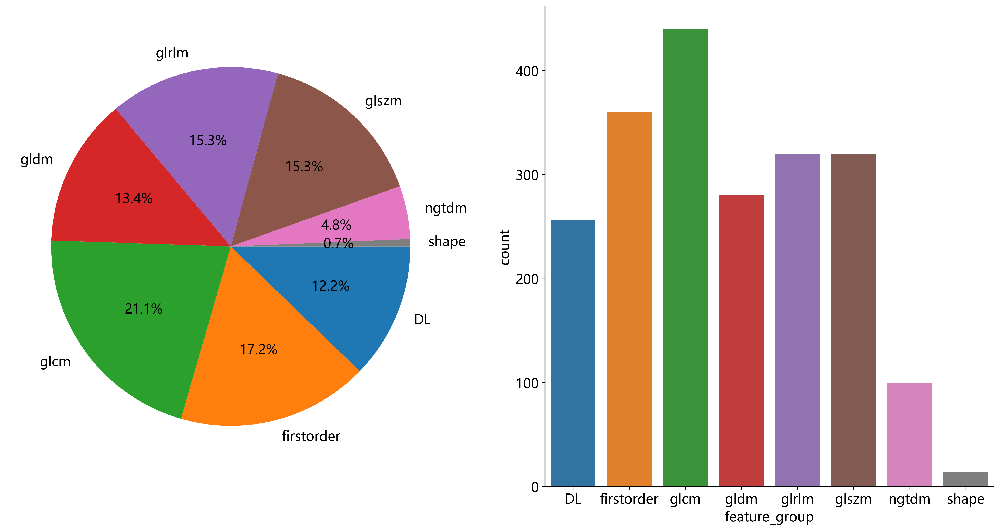

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
sorted_counts = pd.DataFrame([c.split('_')[-2] for c in rad_data.columns if c !='ID']).value_counts()
sorted_counts = pd.DataFrame(sorted_counts, columns=['count']).reset_index()
sorted_counts = sorted_counts.sort_values(0)
sorted_counts.columns = ['feature_group', 'count']
display(sorted_counts)

plt.figure(figsize=(20, 10))
ax = plt.subplot(121)
plt.pie(sorted_counts['count'], labels=[i for i in sorted_counts['feature_group']], startangle=0,
        counterclock = False, autopct = '%.1f%%')
# plt.bar_label(bar.containers[0])
ax = plt.subplot(122)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
bar = sns.barplot(data=sorted_counts, x='feature_group', y='count', )
plt.savefig(f'img/{task_type}feature_ratio.svg', bbox_inches = 'tight')

## 标注数据

数据以csv格式进行存储，这里如果是其他格式，可以使用自定义函数读取出每个样本的结果。

要求label_data为一个`DataFrame`格式，包括ID列以及后续的labels列，可以是多列，支持Multi-Task。

In [6]:
label_data = pd.read_csv(labelf)
label_data = label_data[['ID', group_info] + labels]
label_data

,ID,group,label
0,468.nii.gz,train,1
1,2222.nii.gz,train,0
2,336.nii.gz,train,0
3,660.nii.gz,train,0
4,2279.nii.gz,train,0
...,...,...,...
412,2147.nii.gz,test,0
413,2165.nii.gz,test,0
414,2198.nii.gz,test,0
415,2210.nii.gz,test,1


## 特征拼接 

将标注数据`label_data`与`rad_data`进行合并，得到训练数据。

**注意：** 
1. 需要删掉ID这一列
2. 如果发现数据少了，需要自行检查数据是否匹配。

In [7]:
from onekey_algo.custom.utils import print_join_info

print_join_info(rad_data, label_data)
combined_data = pd.merge(rad_data, label_data, on=['ID'], how='inner')
ids = combined_data['ID']
combined_data = combined_data.drop(['ID'], axis=1)
print(combined_data[labels].value_counts())
combined_data

[2024-03-26 09:24:16 - __init__.py:  58]	WARNING	存在ID特征不完全匹配的问题！在左边不在右边的ID：{'741.nii.gz', '3022.nii.gz', '589.nii.gz', '81.nii.gz', '576.nii.gz', '889.nii.gz', '3002.nii.gz', '725.nii.gz', '2181.nii.gz', '2171.nii.gz', '2233.nii.gz', '2162.nii.gz', '820(2).nii.gz', '3033.nii.gz', '417.nii.gz', '2204.nii.gz', '1850.nii.gz', '2263.nii.gz', '989.nii.gz'}；在右边不在左边的ID：set()


label
0        261
1        156
dtype: int64


,DL_1,DL_2,DL_3,DL_4,DL_5,DL_6,DL_7,DL_8,DL_9,DL_10,...,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZonePercentage,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength,group,label
0,-1.172,-0.975,-3.688,-0.943,-5.832,1.313,0.191,1.846,-1.710,3.172,...,7.640,0.630,2.232,0.128,0.002,29171.708,0.358,13.208,train,0
1,1.605,-7.205,-2.441,-0.940,1.294,2.045,-1.948,0.547,1.130,-1.290,...,7.099,0.752,3.199,0.019,0.008,51645.571,2.040,45.373,train,0
2,-8.683,6.313,-3.535,1.016,6.970,2.637,0.446,-0.872,-2.430,-0.426,...,6.974,0.537,3.418,0.105,0.007,8596.375,0.199,17.727,train,0
3,4.042,-7.547,-4.140,-0.025,0.741,2.556,-1.224,1.692,0.374,-1.163,...,7.457,0.691,2.979,0.055,0.004,31422.200,1.040,15.276,val,1
4,-0.927,2.566,-1.254,0.221,-5.542,-4.405,0.032,-1.045,0.128,1.522,...,7.357,0.726,0.809,0.072,0.005,31751.372,0.587,24.500,val,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
412,-3.235,-1.545,-0.154,2.367,-3.730,1.398,4.547,0.432,-2.985,-3.019,...,7.294,0.741,0.675,0.062,0.006,32761.794,0.727,23.282,train,0
413,-4.010,-3.216,3.387,-2.264,2.952,4.594,1.260,-0.686,-0.308,-0.342,...,7.066,0.612,1.957,0.132,0.006,10982.727,0.361,16.582,train,0
414,-6.222,-0.756,-0.444,-0.568,1.684,1.520,-0.903,1.082,1.062,-1.056,...,7.098,0.472,8.817,0.155,0.005,8880.995,0.188,14.369,train,0
415,-3.331,0.240,-1.397,-4.413,-0.670,-0.838,1.448,-0.795,-2.118,-2.135,...,7.813,0.607,2.443,0.275,0.001,22973.139,0.428,6.082,train,0


## 获取到数据的统计信息

1. count，统计样本个数。
2. mean、std, 对应特征的均值、方差
3. min, 25%, 50%, 75%, max，对应特征的最小值，25,50,75分位数，最大值。

In [8]:
combined_data.describe()

,DL_1,DL_2,DL_3,DL_4,DL_5,DL_6,DL_7,DL_8,DL_9,DL_10,...,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZonePercentage,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength,label
count,417.000,417.000,417.000,417.000,417.000,4.170e+02,417.000,417.000,417.000,417.000,...,4.170e+02,417.000,417.000,417.000,417.000,4.170e+02,417.000,417.000,417.000,417.000
mean,-0.052,0.005,-0.053,-0.021,0.003,8.242e-04,-0.016,0.008,-0.038,-0.016,...,4.705e-03,7.086,0.676,17.620,0.080,7.931e-03,25666.555,0.734,25.912,0.374
std,4.478,3.492,3.080,2.572,2.495,2.341e+00,2.051,2.049,1.921,1.860,...,4.033e-03,0.430,0.100,117.659,0.061,7.057e-03,15477.554,0.581,19.433,0.484
min,-9.708,-9.157,-7.272,-6.246,-6.650,-6.256e+00,-6.124,-5.274,-6.454,-6.845,...,2.192e-04,5.215,0.378,0.064,0.006,6.806e-04,674.964,0.097,3.089,0.000
25%,-3.619,-2.338,-2.547,-1.599,-1.818,-1.608e+00,-1.380,-1.413,-1.313,-1.169,...,2.000e-03,6.830,0.612,0.725,0.037,3.255e-03,14967.922,0.390,13.626,0.000
50%,-0.491,0.297,0.048,-0.128,0.170,-3.978e-02,0.032,-0.051,-0.099,0.001,...,3.601e-03,7.155,0.692,1.361,0.063,6.249e-03,25428.014,0.625,20.351,0.000
75%,3.426,2.506,2.237,1.733,1.771,1.707e+00,1.344,1.382,1.110,1.091,...,6.300e-03,7.398,0.747,3.250,0.107,1.003e-02,33721.687,0.965,34.334,1.000
max,11.491,9.570,8.002,7.199,7.052,7.232e+00,6.157,7.530,6.799,6.879,...,3.141e-02,8.008,0.936,1792.395,0.347,5.858e-02,131358.353,8.854,172.580,1.000


## 正则化

`normalize_df` 为onekey中正则化的API，将数据变化到0均值1方差。正则化的方法为

$column = \frac{column - mean}{std}$

In [9]:
from onekey_algo.custom.components.comp1 import normalize_df
data = normalize_df(combined_data, not_norm=labels, group=group_info, use_train=True)
data = data.dropna(axis=1)
data.describe()

[2024-03-26 09:24:17 - comp1.py: 186]	INFO	正在使用训练集预定数据进行标准化。


,DL_1,DL_2,DL_3,DL_4,DL_5,DL_6,DL_7,DL_8,DL_9,DL_10,...,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZonePercentage,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength,label
count,417.000,417.000,417.000,417.000,417.000,417.000,417.000,417.000,417.000,417.000,...,417.000,4.170e+02,417.000,417.000,417.000,417.000,417.000,417.000,417.000,417.000
mean,0.177,0.096,0.073,-0.018,0.033,-0.091,0.010,0.092,0.029,0.035,...,-0.093,1.482e-04,0.028,0.039,-0.115,0.005,0.057,-0.024,0.061,0.374
std,1.052,0.962,0.989,1.017,0.994,0.984,0.972,1.036,0.985,1.014,...,0.886,9.567e-01,1.029,1.229,0.966,0.981,1.025,0.829,1.068,0.484
min,-2.091,-2.429,-2.247,-2.480,-2.618,-2.722,-2.884,-2.579,-3.262,-3.690,...,-1.078,-4.160e+00,-3.040,-0.144,-1.299,-1.003,-1.599,-0.932,-1.193,0.000
25%,-0.661,-0.549,-0.729,-0.643,-0.693,-0.768,-0.637,-0.626,-0.625,-0.594,...,-0.687,-5.695e-01,-0.623,-0.137,-0.811,-0.645,-0.652,-0.514,-0.614,0.000
50%,0.074,0.177,0.105,-0.061,0.099,-0.108,0.033,0.062,-0.002,0.044,...,-0.336,1.532e-01,0.199,-0.130,-0.394,-0.229,0.041,-0.180,-0.245,0.000
75%,0.994,0.786,0.808,0.675,0.737,0.626,0.654,0.787,0.618,0.638,...,0.257,6.930e-01,0.762,-0.111,0.300,0.296,0.591,0.306,0.524,1.000
max,2.889,2.733,2.660,2.837,2.842,2.949,2.934,3.895,3.536,3.795,...,5.770,2.049e+00,2.719,18.577,4.114,7.046,7.059,11.553,8.122,1.000


## 统计检验

通过ttest或者utest进行特征筛选。

**注意** ：此步骤不是论文的标配，所以用不用在自己的选择，可以通过修改pvalue的值进行调整，默认是0.05为显著。

In [10]:
import seaborn as sns
from onekey_algo.custom.components.stats import clinic_stats

stats = clinic_stats(data[data['group'] == 'train'], stats_columns=list(data.columns[0:-2]), label_column=labels[0], 
                     continuous_columns=list(data.columns[0:-2]))
stats

,feature_name,-label=ALL,-label=0,-label=1,pvalue
0,DL_1,-0.00±1.00,-0.50±0.75,0.76±0.85,<0.001
1,DL_2,-0.00±1.00,0.22±0.94,-0.34±0.99,<0.001
2,DL_3,0.00±1.00,0.07±1.02,-0.11±0.96,0.166
3,DL_4,-0.00±1.00,-0.12±1.04,0.18±0.92,0.033
4,DL_5,-0.00±1.00,0.01±1.06,-0.01±0.91,0.908
...,...,...,...,...,...
2085,intra_wavelet_LLL_ngtdm_Busyness,-0.00±1.00,0.12±1.02,-0.19±0.95,0.003
2086,intra_wavelet_LLL_ngtdm_Coarseness,0.00±1.00,0.09±0.88,-0.13±1.15,0.003
2087,intra_wavelet_LLL_ngtdm_Complexity,-0.00±1.00,-0.22±1.02,0.34±0.87,<0.001
2088,intra_wavelet_LLL_ngtdm_Contrast,0.00±1.00,-0.25±0.50,0.38±1.39,<0.001


#### 输出特征分布的图

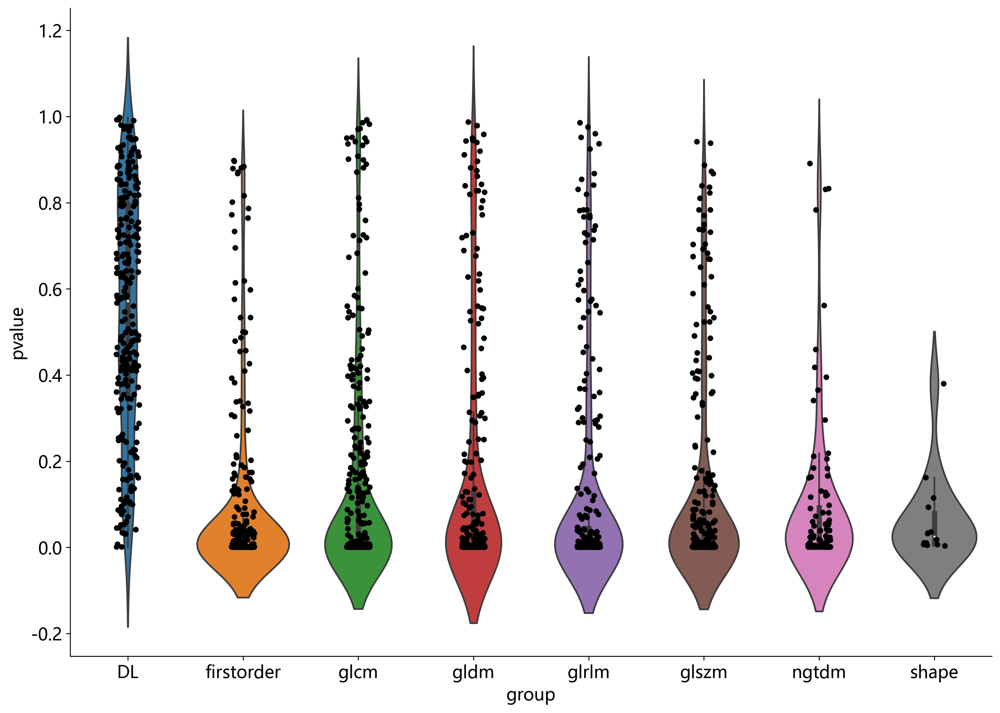

In [11]:
import matplotlib.pyplot as plt

def map2float(x):
    try:
        return float(str(x)[1:])
    except:
        return 1

stats[['pvalue']] = stats[['pvalue']].applymap(map2float)
stats[['group']] = stats[['feature_name']].applymap(lambda x: x.split('_')[-2])
stats = stats[['feature_name', 'pvalue', 'group']]
g = sns.catplot(x="group", y="pvalue", data=stats, kind="violin")
g.fig.set_size_inches(15,10)
sns.stripplot(x="group", y="pvalue", data=stats, ax=g.ax, color='black')
plt.savefig(f'img/{task_type}feature_stats.svg', bbox_inches = 'tight')

#### 调整pvalue进行筛选。

In [12]:
pvalue = 0.05
sel_feature = list(stats[stats['pvalue'] < pvalue]['feature_name']) + labels + [group_info]
data = data[sel_feature]
data

,DL_1,DL_2,DL_4,DL_30,DL_73,DL_88,DL_107,DL_192,DL_241,intra_exponential_firstorder_10Percentile,...,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength,label,group
25,0.194,0.436,-0.573,0.632,1.125,-0.646,0.497,0.522,1.154,0.270,...,1.018,-2.215,-0.117,-0.259,1.279,-1.406,-0.682,-0.613,0,test
29,1.068,1.587,-1.457,1.855,0.012,0.943,0.920,-2.596,-1.572,-0.129,...,-0.364,0.165,-0.122,0.535,-0.674,-0.079,-0.758,-0.326,0,test
33,2.089,1.323,-0.887,-0.703,-0.531,0.669,-1.245,0.050,1.205,0.472,...,-0.946,1.109,-0.100,-0.444,-0.691,0.432,0.009,-0.604,1,test
34,1.926,1.384,-0.432,-0.265,1.035,1.644,-0.558,0.358,-0.441,0.359,...,-0.449,0.729,-0.132,-0.854,-0.193,0.494,0.588,0.080,1,test
36,2.257,0.791,-0.133,-0.043,-0.089,1.271,-0.109,-0.423,-0.712,2.426,...,-0.814,0.285,0.284,-0.982,-0.674,0.702,-0.538,-0.245,1,test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397,-0.429,-1.538,-1.554,-0.762,-0.201,1.191,-0.006,0.980,-0.045,-0.506,...,0.303,-1.503,-0.135,-0.557,1.063,-1.078,0.211,-0.165,0,val
404,0.353,-1.254,0.189,0.822,-1.105,0.157,-1.046,0.235,-0.734,-0.582,...,0.049,0.198,-0.138,-0.836,0.344,0.747,0.433,1.222,0,val
405,2.048,0.037,-0.684,-0.256,0.661,0.601,-0.442,-0.375,-0.640,1.613,...,-0.115,-0.965,-0.143,-1.215,1.564,1.139,0.952,2.164,1,val
407,1.018,0.343,1.874,-1.306,-1.650,0.538,0.298,-0.521,0.714,0.275,...,-0.954,0.786,-0.128,0.775,-0.911,0.834,0.292,-1.072,1,val


### 相关系数

计算相关系数的方法有3种可供选择
1. pearson （皮尔逊相关系数）: standard correlation coefficient

2. kendall (肯德尔相关性系数) : Kendall Tau correlation coefficient

3. spearman (斯皮尔曼相关性系数): Spearman rank correlation

三种相关系数参考：https://blog.csdn.net/zmqsdu9001/article/details/82840332

In [13]:
pearson_corr = data[data['group'] == 'train'][[c for c in data.columns if c not in labels]].corr('pearson')
# kendall_corr = data[[c for c in data.columns if c not in labels]].corr('kendall')
# spearman_corr = data[[c for c in data.columns if c not in labels]].corr('spearman')

### 相关系数可视化

通过修改变量名，可以可视化不同相关系数下的相关矩阵。

**注意**：当特征特别多的时候（大于100），尽量不要可视化，否则运行时间会特别长。

In [14]:
import seaborn as sns
from onekey_algo.custom.components.comp1 import draw_matrix

if data.shape[1] < 100:
    plt.figure(figsize=(25.0, 20.0))

    # 选择可视化的相关系数
    draw_matrix(pearson_corr, annot=True, cmap='YlGnBu', cbar=False)
    plt.savefig(f'img/{task_type}feature_corr.svg', bbox_inches = 'tight')

### 聚类分析

通过修改变量名，可以可视化不同相关系数下的相聚类分析矩阵。

注意：当特征特别多的时候（大于100），尽量不要可视化，否则运行时间会特别长。

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt

if data.shape[1] < 100:
    pp = sns.clustermap(pearson_corr, linewidths=.5, figsize=(50.0, 40.0), cmap='YlGnBu')
    plt.setp(pp.ax_heatmap.get_yticklabels(), rotation=0)
    plt.savefig(f'img/{task_type}feature_cluster.svg', bbox_inches = 'tight')

### 特征筛选 -- 相关系数

根据相关系数，对于相关性比较高的特征（一般文献取corr>0.9），两者保留其一。

```python
def select_feature(corr, threshold: float = 0.9, keep: int = 1, topn=10, verbose=False):
    """
    * corr, 相关系数矩阵。
    * threshold，筛选的相关系数的阈值，大于阈值的两者保留其一（可以根据keep修改，可以是其二...）。默认阈值为0.9
    * keep，可以选择大于相关系数，保留几个，默认只保留一个。
    * topn, 每次去掉多少重复特征。
    * verbose，是否打印日志
    """
```

In [16]:
import math
from onekey_algo.custom.components.comp1 import select_feature, select_feature_mrmr

sel_feature = select_feature(pearson_corr, threshold=0.9, topn=128, verbose=False)
# sel_feature = select_feature_mrmr(data[data['group'] == 'train'][sel_feature + labels], num_features=64)
sel_feature += labels + [group_info]
sel_feature

['DL_1',
 'DL_2',
 'DL_4',
 'DL_30',
 'DL_73',
 'DL_88',
 'DL_107',
 'DL_192',
 'DL_241',
 'intra_exponential_firstorder_10Percentile',
 'intra_exponential_firstorder_Kurtosis',
 'intra_exponential_firstorder_Minimum',
 'intra_exponential_firstorder_Skewness',
 'intra_exponential_glcm_Correlation',
 'intra_exponential_glcm_Imc1',
 'intra_exponential_glcm_Imc2',
 'intra_exponential_glcm_InverseVariance',
 'intra_exponential_gldm_DependenceEntropy',
 'intra_exponential_gldm_DependenceVariance',
 'intra_exponential_gldm_LargeDependenceHighGrayLevelEmphasis',
 'intra_exponential_gldm_LowGrayLevelEmphasis',
 'intra_exponential_glrlm_GrayLevelNonUniformityNormalized',
 'intra_exponential_glrlm_RunVariance',
 'intra_exponential_glrlm_ShortRunHighGrayLevelEmphasis',
 'intra_exponential_glrlm_ShortRunLowGrayLevelEmphasis',
 'intra_exponential_glszm_SizeZoneNonUniformityNormalized',
 'intra_exponential_ngtdm_Busyness',
 'intra_exponential_ngtdm_Coarseness',
 'intra_exponential_ngtdm_Strength',
 

### 过滤特征

通过`sel_feature`过滤出筛选出来的特征。

In [17]:
sel_data = data[sel_feature]
sel_data

,DL_1,DL_2,DL_4,DL_30,DL_73,DL_88,DL_107,DL_192,DL_241,intra_exponential_firstorder_10Percentile,...,intra_wavelet_LLL_glszm_SmallAreaLowGrayLevelEmphasis,intra_wavelet_LLL_glszm_ZoneEntropy,intra_wavelet_LLL_glszm_ZoneVariance,intra_wavelet_LLL_ngtdm_Busyness,intra_wavelet_LLL_ngtdm_Coarseness,intra_wavelet_LLL_ngtdm_Complexity,intra_wavelet_LLL_ngtdm_Contrast,intra_wavelet_LLL_ngtdm_Strength,label,group
25,0.194,0.436,-0.573,0.632,1.125,-0.646,0.497,0.522,1.154,0.270,...,1.018,-2.215,-0.117,-0.259,1.279,-1.406,-0.682,-0.613,0,test
29,1.068,1.587,-1.457,1.855,0.012,0.943,0.920,-2.596,-1.572,-0.129,...,-0.364,0.165,-0.122,0.535,-0.674,-0.079,-0.758,-0.326,0,test
33,2.089,1.323,-0.887,-0.703,-0.531,0.669,-1.245,0.050,1.205,0.472,...,-0.946,1.109,-0.100,-0.444,-0.691,0.432,0.009,-0.604,1,test
34,1.926,1.384,-0.432,-0.265,1.035,1.644,-0.558,0.358,-0.441,0.359,...,-0.449,0.729,-0.132,-0.854,-0.193,0.494,0.588,0.080,1,test
36,2.257,0.791,-0.133,-0.043,-0.089,1.271,-0.109,-0.423,-0.712,2.426,...,-0.814,0.285,0.284,-0.982,-0.674,0.702,-0.538,-0.245,1,test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397,-0.429,-1.538,-1.554,-0.762,-0.201,1.191,-0.006,0.980,-0.045,-0.506,...,0.303,-1.503,-0.135,-0.557,1.063,-1.078,0.211,-0.165,0,val
404,0.353,-1.254,0.189,0.822,-1.105,0.157,-1.046,0.235,-0.734,-0.582,...,0.049,0.198,-0.138,-0.836,0.344,0.747,0.433,1.222,0,val
405,2.048,0.037,-0.684,-0.256,0.661,0.601,-0.442,-0.375,-0.640,1.613,...,-0.115,-0.965,-0.143,-1.215,1.564,1.139,0.952,2.164,1,val
407,1.018,0.343,1.874,-1.306,-1.650,0.538,0.298,-0.521,0.714,0.275,...,-0.954,0.786,-0.128,0.775,-0.911,0.834,0.292,-1.072,1,val


### 样本可视化

根据特征和label信息，将rad features降维到2维，看不同的label样本在二维空间的分布。

**注意**：由于特征空间维度极高，降维难免会有损失，所以二维的可视化仅供参考。

目前支持的:

| **降维方法** | **Method名称**                                                 |
| ------------ | ------------------------------------------------------------ |
| LLE      | Standard LLE, Modified LLE                                   |
| PCA      | t-SNE, NCA                                                      |
| SVD      | Truncated SVD                                              |
| Model Based      | Random projection, Isomap, MDS, Random Trees,Spectral       |

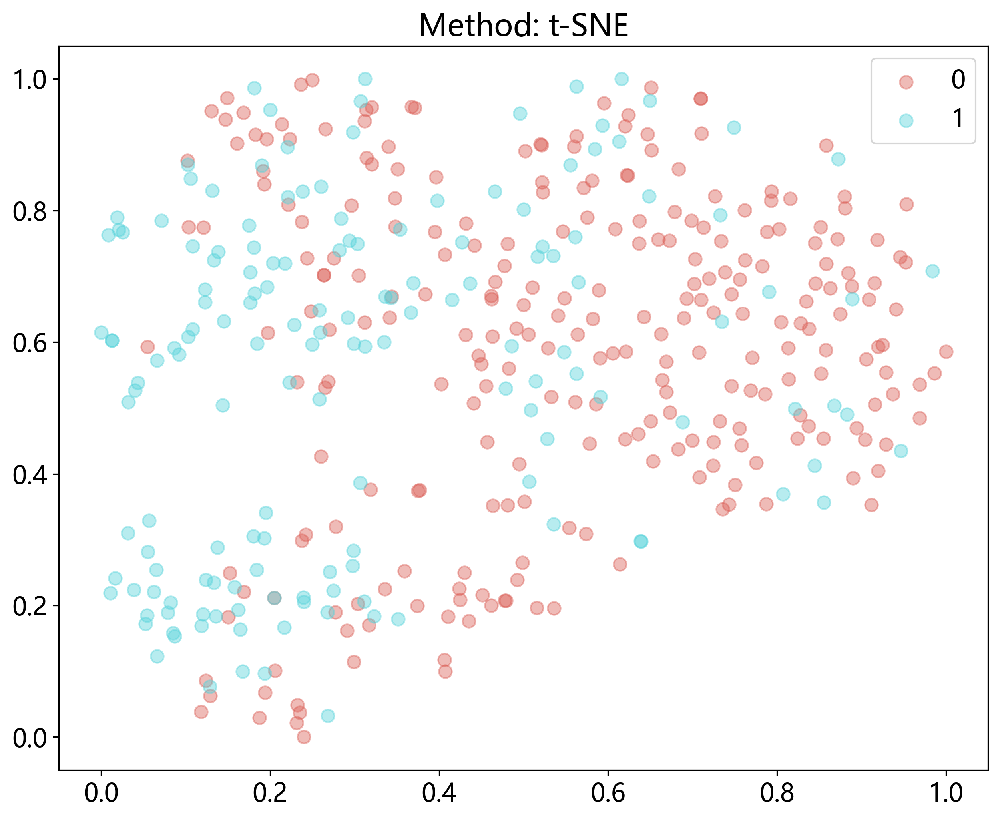

In [18]:
from onekey_algo.custom.components.comp1 import analysis_features
analysis_features(data[sel_feature[:-2]], data[labels[0]], methods='t-SNE', save_dir='img', prefix=task_type)

## 构建数据

将样本的训练数据X与监督信息y分离出来，并且对训练数据进行划分，一般的划分原则为80%-20%

In [19]:
import numpy as np
import onekey_algo.custom.components as okcomp
from collections import OrderedDict
n_classes = 2
train_data = sel_data[(sel_data[group_info] == 'train')]
train_ids = ids[train_data.index]
train_data = train_data.reset_index()
train_data = train_data.drop('index', axis=1)
y_data = train_data[labels]
X_data = train_data.drop(labels + [group_info], axis=1)

subsets = [s.lower() for s in get_param_in_cwd('subsets') if s.lower() != 'train']
val_datasets = OrderedDict()
for subset in subsets:
    val_data = sel_data[sel_data[group_info] == subset]
    val_ids = ids[val_data.index]
    val_data = val_data.reset_index()
    val_data = val_data.drop('index', axis=1)
    y_val_data = val_data[labels]
    X_val_data = val_data.drop(labels + [group_info], axis=1)
    val_datasets[subset] = [X_val_data, y_val_data, val_ids]

y_all_data = sel_data[labels]
X_all_data = sel_data.drop(labels + [group_info], axis=1)

column_names = X_data.columns
print(f"训练集样本数：{X_data.shape}，", '，'.join([f"{subset}样本数：{d_[0].shape}" for subset, d_ in val_datasets.items()]))

训练集样本数：(223, 363)， val样本数：(96, 363)，test样本数：(98, 363)


### Lasso

初始化Lasso模型，alpha为惩罚系数。具体的参数文档可以参考：[文档](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html?highlight=lasso#sklearn.linear_model.Lasso)

### 交叉验证

不同Lambda下的，特征的的权重大小。
```python
def lasso_cv_coefs(X_data, y_data, points=50, column_names: List[str] = None, **kwargs):
    """

    Args:
        X_data: 训练数据
        y_data: 监督数据
        points: 打印多少个点。默认50
        column_names: 列名，默认为None，当选择的数据很多的时候，建议不要添加此参数
        **kwargs: 其他用于打印控制的参数。

    """
 ```

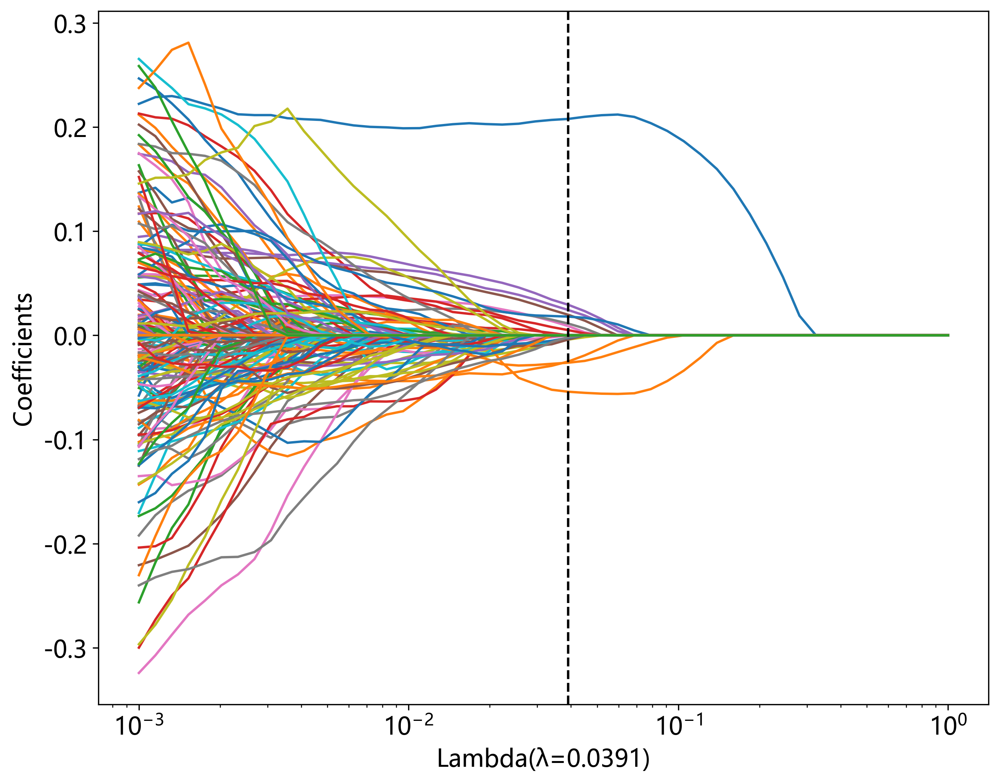

In [20]:
alpha = okcomp.comp1.lasso_cv_coefs(X_data, y_data, column_names=None)
plt.savefig(f'img/{task_type}feature_lasso.svg', bbox_inches = 'tight')

### 模型效能

```python
def lasso_cv_efficiency(X_data, y_data, points=50, **kwargs):
    """

    Args:
        Xdata: 训练数据
        ydata: 测试数据
        points: 打印的数据密度
        **kwargs: 其他的图像样式
            # 数据点标记, fmt="o"
            # 数据点大小, ms=3
            # 数据点颜色, mfc="r"
            # 数据点边缘颜色, mec="r"
            # 误差棒颜色, ecolor="b"
            # 误差棒线宽, elinewidth=2
            # 误差棒边界线长度, capsize=2
            # 误差棒边界厚度, capthick=1
    Returns:
    """
 ```

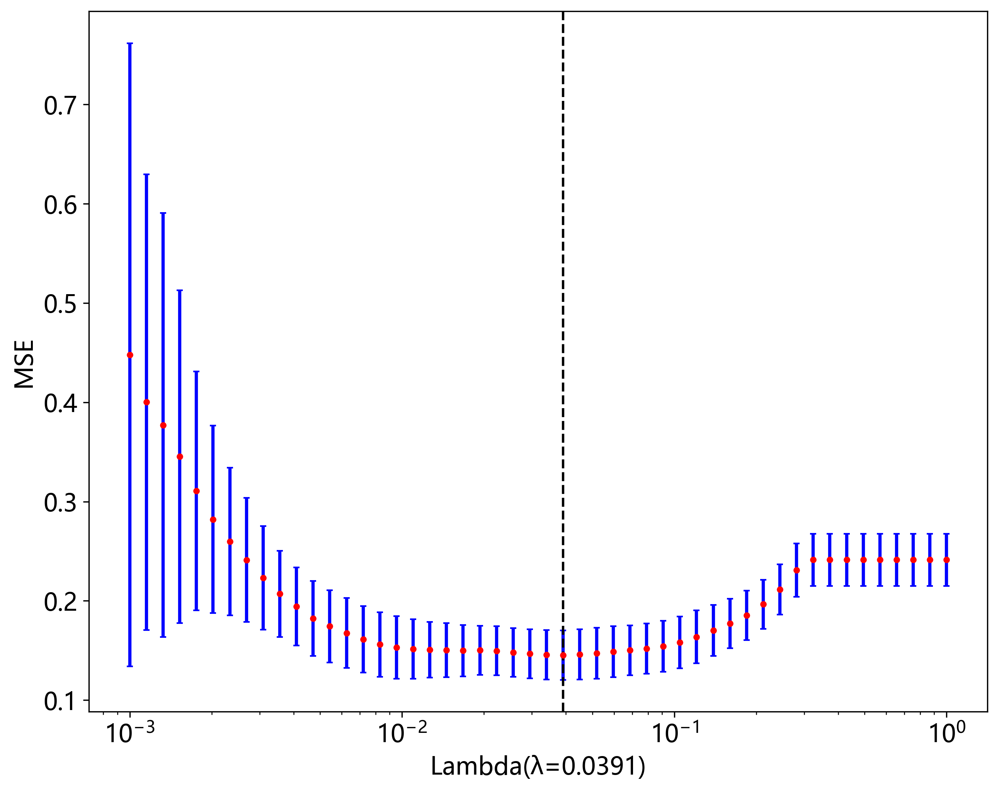

In [21]:
okcomp.comp1.lasso_cv_efficiency(X_data, y_data, points=50)
plt.savefig(f'img/{task_type}feature_mse.svg', bbox_inches = 'tight')

### 惩罚系数

使用交叉验证的惩罚系数作为模型训练的基础。

In [22]:
from sklearn import linear_model

models = []
for label in labels:
    clf = linear_model.Lasso(alpha=alpha)
    clf.fit(X_data, y_data[label])
    models.append(clf)

### 特征筛选

筛选出其中coef > 0的特征。并且打印出相应的公式。

In [23]:
COEF_THRESHOLD = 1e-6 # 筛选的特征阈值
scores = []
selected_features = []
for label, model in zip(labels, models):
    feat_coef = [(feat_name, coef) for feat_name, coef in zip(column_names, model.coef_) 
                 if COEF_THRESHOLD is None or abs(coef) > COEF_THRESHOLD]
    selected_features.append([feat for feat, _ in feat_coef])
    formula = ' '.join([f"{coef:+.6f} * {feat_name}" for feat_name, coef in feat_coef])
    score = f"{label} = {model.intercept_} {'+' if formula[0] != '-' else ''} {formula}"
    scores.append(score)
    
print(scores[0])

label = 0.39461883408071746 + +0.207811 * DL_1 -0.025152 * DL_2 +0.029328 * DL_73 +0.019735 * DL_88 +0.008882 * DL_107 +0.011325 * DL_192 -0.003763 * DL_241 -0.004078 * intra_exponential_ngtdm_Strength -0.054124 * intra_gradient_firstorder_Skewness +0.004977 * intra_lbp_3D_k_glcm_Imc2 +0.024284 * intra_lbp_3D_m1_glszm_SmallAreaEmphasis -0.002189 * intra_log_sigma_2_0_mm_3D_glcm_ClusterProminence -0.026251 * intra_square_firstorder_Skewness -0.004013 * intra_square_ngtdm_Strength +0.017973 * intra_squareroot_glszm_SmallAreaEmphasis -0.002314 * intra_wavelet_HLH_firstorder_Skewness -0.001731 * intra_wavelet_LLH_firstorder_RootMeanSquared


### 特征权重

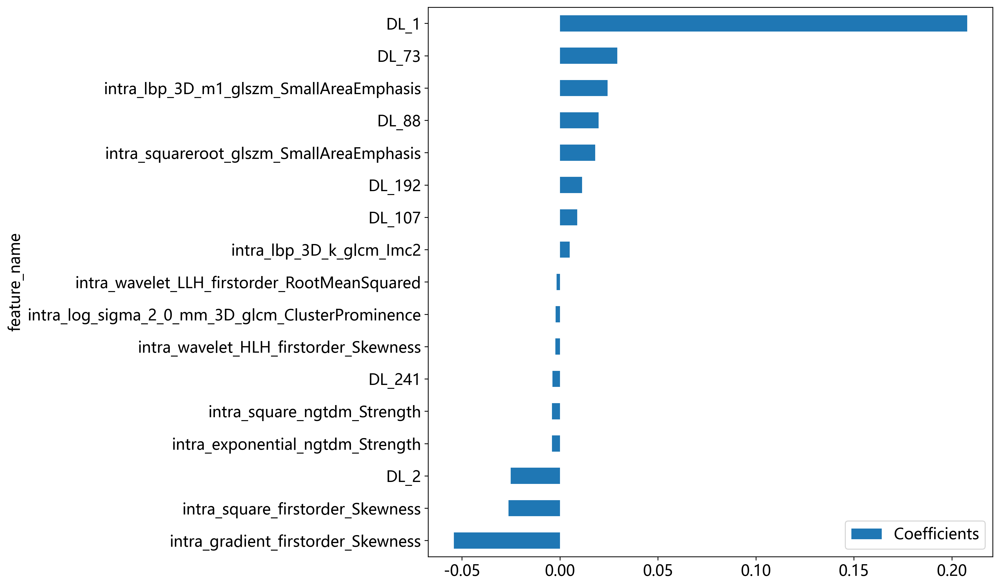

In [24]:
feat_coef = sorted(feat_coef, key=lambda x: x[1])
feat_coef_df = pd.DataFrame(feat_coef, columns=['feature_name', 'Coefficients'])
feat_coef_df.plot(x='feature_name', y='Coefficients', kind='barh', figsize=(10, 10))

plt.savefig(f'img/{task_type}feature_weights.svg', bbox_inches = 'tight')

### 进一步筛选特征

使用Lasso筛选出来的Coefficients比较高的特征作为训练数据。

In [25]:
X_data = X_data[selected_features[0]]
for subset in val_datasets:
    val_datasets[subset][0] = val_datasets[subset][0][selected_features[0]]
pd.concat([ids, combined_data[selected_features[0]]], axis=1).to_csv(f'features/{task_type}rad_sel_features.csv', index=False)
X_data.columns

Index(['DL_1', 'DL_2', 'DL_73', 'DL_88', 'DL_107', 'DL_192', 'DL_241',
       'intra_exponential_ngtdm_Strength',
       'intra_gradient_firstorder_Skewness', 'intra_lbp_3D_k_glcm_Imc2',
       'intra_lbp_3D_m1_glszm_SmallAreaEmphasis',
       'intra_log_sigma_2_0_mm_3D_glcm_ClusterProminence',
       'intra_square_firstorder_Skewness', 'intra_square_ngtdm_Strength',
       'intra_squareroot_glszm_SmallAreaEmphasis',
       'intra_wavelet_HLH_firstorder_Skewness',
       'intra_wavelet_LLH_firstorder_RootMeanSquared'],
      dtype='object')

## 模型筛选

根据筛选出来的数据，做模型的初步选择。当前主要使用到的是Onekey中的

1. SVM，支持向量机，引用参考。
2. KNN，K紧邻，引用参考。
3. Decision Tree，决策树，引用参考。
4. Random Forests, 随机森林，引用参考。
5. XGBoost, bosting方法。引用参考。
6. LightGBM, bosting方法，引用参考。

In [26]:
model_names = get_param_in_cwd('ml_models')
models = okcomp.comp1.create_clf_model(model_names)
model_names = list(models.keys())

### 交叉验证

`n_trails`指定随机次数，每次采用的是80%训练，随机20%进行测试，找到最好的模型，以及对应的最好的数据划分。


```python
def get_bst_split(X_data: pd.DataFrame, y_data: pd.DataFrame,
            models: dict, test_size=0.2, metric_fn=accuracy_score, n_trails=10,
            cv: bool = False, shuffle: bool = False, metric_cut_off: float = None, random_state=None):
    """
    寻找数据集中最好的数据划分。
    Args:
        X_data: 训练数据
        y_data: 监督数据
        models: 模型名称，Dict类型、
        test_size: 测试集比例，只有当cv=False时生效
        metric_fn: 评价模型好坏的函数，默认准确率，可选roc_auc_score。
        n_trails: 尝试多少次寻找最佳数据集划分。
        cv: 是否是交叉验证，默认是False，当为True时，n_trails为交叉验证的n_fold
        shuffle: 是否进行随机打乱
        metric_cut_off: 当metric_fn的值达到多少时进行截断。
        random_state: 随机种子

    Returns: {'max_idx': max_idx, "max_model": max_model, "max_metric": max_metric, "results": results}

    """
```

**注意：这里采用了【挑数据】，如果想要严谨，请修改`n_trails=1`。**

[2024-03-26 09:24:44 - comp1.py: 473]	WARNING	当cv=True的时候，采用的是交叉验证的模式，此时test_size的参数是不生效的，我们将忽略这个test_size设置。如果需要手动指定测试集比例，请修改cv=False。


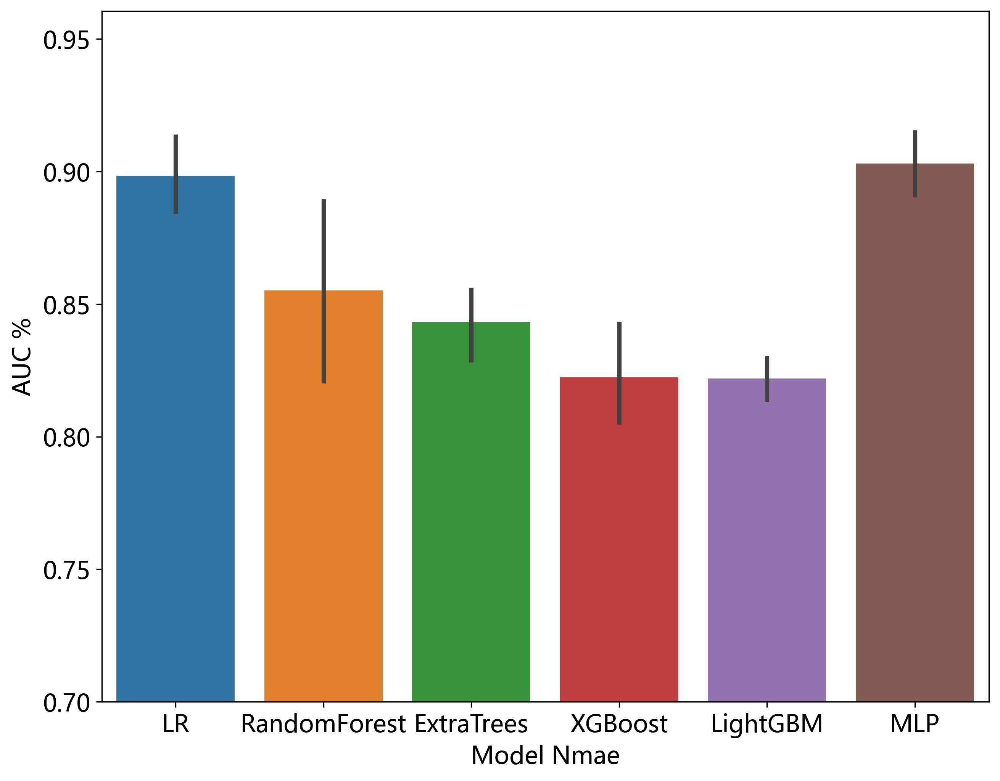

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import accuracy_score, roc_auc_score

# 随机使用n_trails次数据划分，找到最好的一次划分方法，并且保存在results中。
results = okcomp.comp1.get_bst_split(X_data, y_data, models, test_size=0.2, metric_fn=roc_auc_score, n_trails=5, cv=True, random_state=0)
_, (X_train_sel, X_test_sel, y_train_sel, y_test_sel) = results['results'][results['max_idx']]
trails, _ = zip(*results['results'])
cv_results = pd.DataFrame(trails, columns=model_names)
# 可视化每个模型在不同的数据划分中的效果。
sns.barplot(data=cv_results)
plt.ylabel('AUC %')
plt.ylim(0.7)
plt.xlabel('Model Nmae')
plt.savefig(f'img/{task_type}model_cv.svg', bbox_inches = 'tight')

## 模型筛选

使用最好的数据划分，进行后续的模型研究。

**注意**: 一般情况下论文使用的是随机划分的数据，但也有些论文使用【刻意】筛选的数据划分。

In [55]:
import joblib
from onekey_algo.custom.components.comp1 import plot_feature_importance, smote_resample
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier

targets = []
os.makedirs('models', exist_ok=True)
for l in labels:
    new_models = okcomp.comp1.create_clf_model(model_names)
    new_models['LR'] = LogisticRegression(penalty='none', max_iter=100)
    new_models['LightGBM'] = LGBMClassifier(n_estimators=10, max_depth=3, random_state=0)
    new_models['RandomForest'] = RandomForestClassifier(n_estimators=50, max_depth=3,
                                                        min_samples_split=2, random_state=0)
    new_models['ExtraTrees'] = ExtraTreesClassifier(n_estimators=50, max_depth=3, min_samples_split=2, random_state=0)
    new_models['MLP'] = MLPClassifier(hidden_layer_sizes=(64, 32, 16), max_iter=100, solver='adam', random_state=0)
    new_models['XGBoost'] = XGBClassifier(n_estimators=6, objective='binary:logistic', max_depth=3, min_child_weight=.2,
                                              use_label_encoder=False, eval_metric='error')
    model_names = list(new_models.keys())
    new_models = list(new_models.values())
    for mn, m in zip(model_names, new_models):        
        X_train_sel, y_train_sel = X_data, y_data
#         X_train_sel, y_train_sel = smote_resample(X_train_sel, y_train_sel)
        m.fit(X_train_sel, y_train_sel[l])
        # 保存训练的模型
#         joblib.dump(m, f'models/{task_type}{mn}_{l}.pkl') 
        # 输出模型特征重要性，只针对高级树模型有用
#         plot_feature_importance(m, X_data.columns, save_dir='img', prefix=f"{task_type}", figsize=(10, 15))
    targets.append(new_models)

## 预测结果

* predictions，二维数据，每个label对应的每个模型的预测结果。
* pred_scores，二维数据，每个label对应的每个模型的预测概率值。

In [56]:
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import OneHotEncoder
from onekey_algo.custom.components.delong import calc_95_CI
from onekey_algo.custom.components.metrics import analysis_pred_binary

metric = []
pred_sel_idx = []
X_train_sel, y_train_sel = X_data, y_data
predictions = [[(model.predict(X_train_sel), 
                 [(model.predict(X_val_sel), y_val_sel) for X_val_sel, y_val_sel, _ in val_datasets.values()])  
                for model in target] for label, target in zip(labels, targets)]
pred_scores = [[(model.predict_proba(X_train_sel), 
                 [(model.predict_proba(X_val_sel), y_val_sel) for X_val_sel, y_val_sel, _ in val_datasets.values()]) 
                for model in target] for label, target in zip(labels, targets)]

# predictions[0].append(dl_preds)
# pred_scores[0].append(dl_pred_scores)
# model_names.extend(['WG', 'WOG'])
for label, prediction, scores in zip(labels, predictions, pred_scores):
    for mname, (train_pred, val_preds), (train_score, val_scores) in zip(model_names, prediction, scores):
        # 计算训练集指数
        acc, auc, ci, tpr, tnr, ppv, npv, precision, recall, f1, thres = analysis_pred_binary(y_train_sel[label], 
                                                                                              train_score[:, 1])
        ci = f"{ci[0]:.3f} - {ci[1]:.3f}"
        metric.append((mname, acc, auc, ci, tpr, tnr, ppv, npv, precision, recall, f1, thres, f"train"))
        for subset, (val_score, y_val_sel) in zip(val_datasets.keys(), val_scores):
            acc, auc, ci, tpr, tnr, ppv, npv, precision, recall, f1, thres = analysis_pred_binary(y_val_sel[label], 
                                                                                                  val_score[:, 1])
            ci = f"{ci[0]:.3f} - {ci[1]:.3f}"
            metric.append((mname, acc, auc, ci, tpr, tnr, ppv, npv, precision, recall, f1, thres, subset))
metric = pd.DataFrame(metric, index=None, columns=['model_name', 'Accuracy', 'AUC', '95% CI',
                                                   'Sensitivity', 'Specificity', 'PPV', 'NPV', 'Precision', 'Recall', 'F1',
                                                   'Threshold', 'Cohort'])
metric

,model_name,Accuracy,AUC,95% CI,Sensitivity,Specificity,PPV,NPV,Precision,Recall,F1,Threshold,Cohort
0,LR,0.861,0.942,0.914 - 0.971,0.898,0.837,0.782,0.926,0.782,0.898,0.836,0.352,train
1,LR,0.740,0.752,0.637 - 0.867,0.645,0.785,0.588,0.823,0.588,0.645,0.615,0.387,val
2,LR,0.694,0.739,0.636 - 0.842,0.568,0.770,0.600,0.746,0.600,0.568,0.583,0.474,test
3,RandomForest,0.888,0.962,0.942 - 0.983,0.943,0.852,0.806,0.958,0.806,0.943,0.869,0.327,train
4,RandomForest,0.771,0.837,0.751 - 0.923,0.774,0.769,0.615,0.877,0.615,0.774,0.686,0.402,val
5,RandomForest,0.796,0.819,0.723 - 0.915,0.757,0.820,0.718,0.847,0.718,0.757,0.737,0.550,test
6,ExtraTrees,0.843,0.931,0.901 - 0.962,0.932,0.785,0.739,0.946,0.739,0.932,0.824,0.347,train
7,ExtraTrees,0.802,0.793,0.686 - 0.900,0.677,0.862,0.700,0.848,0.700,0.677,0.689,0.441,val
8,ExtraTrees,0.786,0.811,0.715 - 0.908,0.703,0.836,0.722,0.823,0.722,0.703,0.712,0.485,test
9,XGBoost,0.924,0.983,0.969 - 0.996,0.977,0.889,0.851,0.984,0.851,0.977,0.910,0.372,train


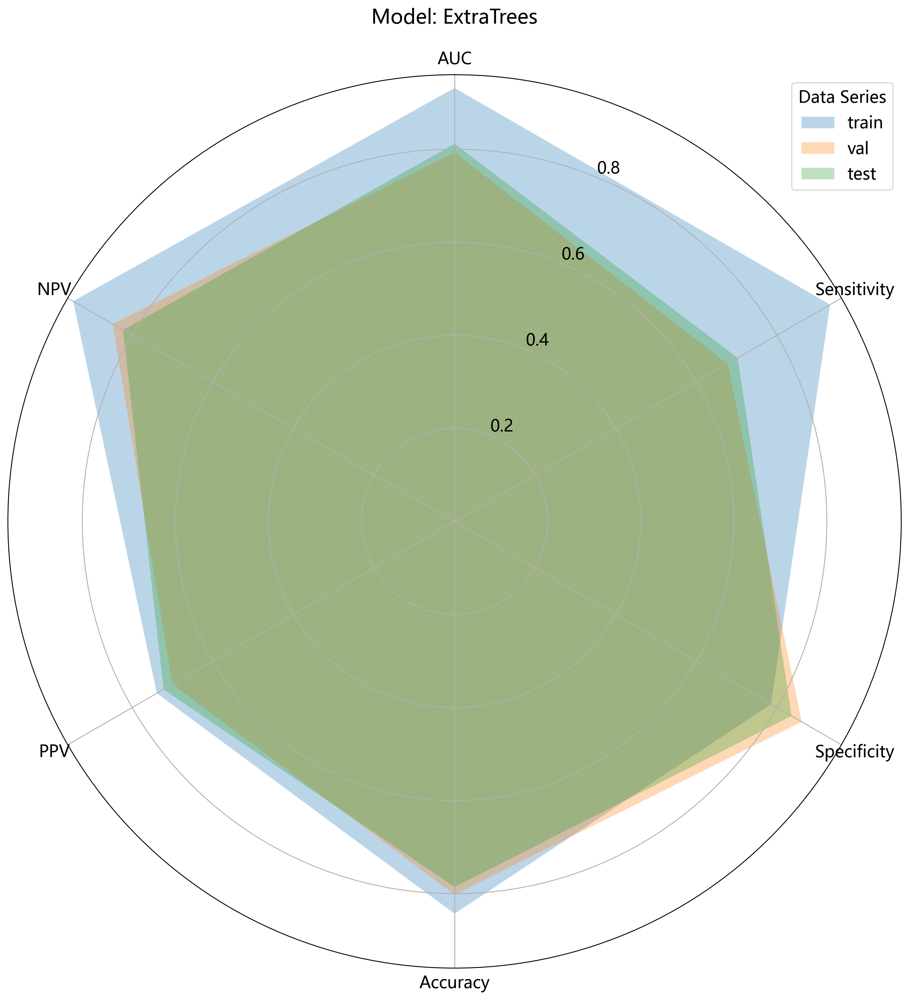

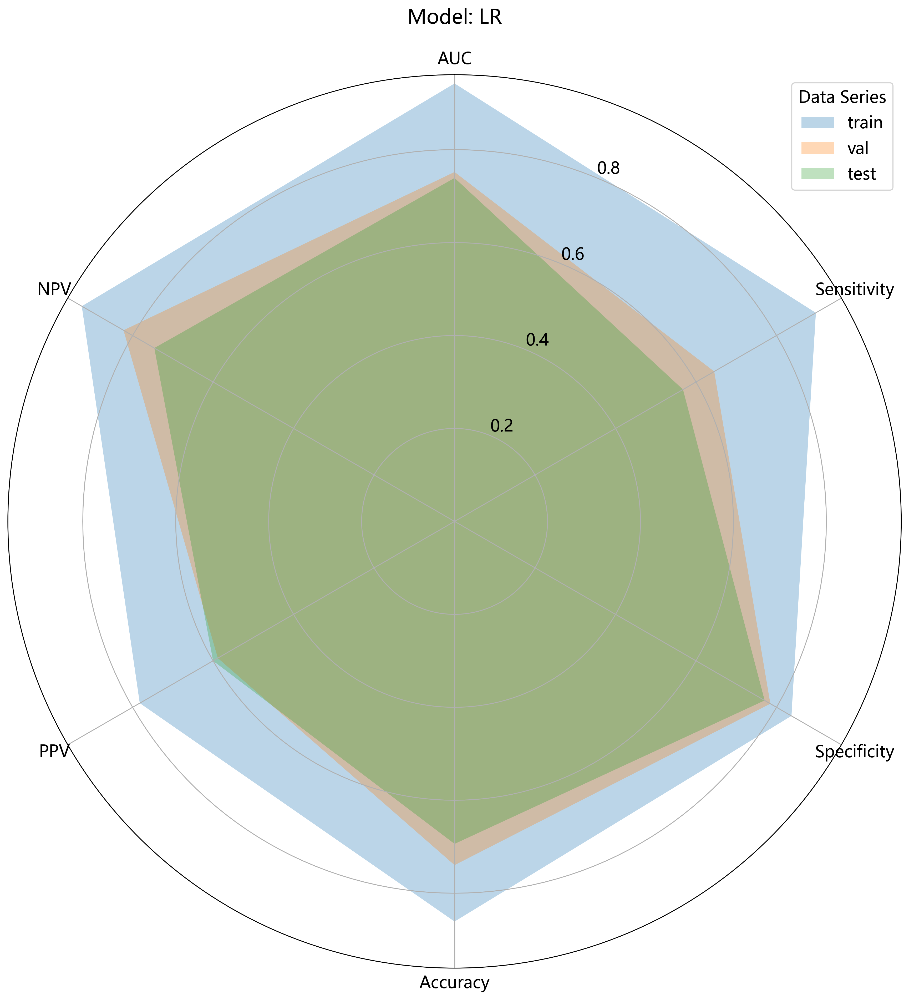

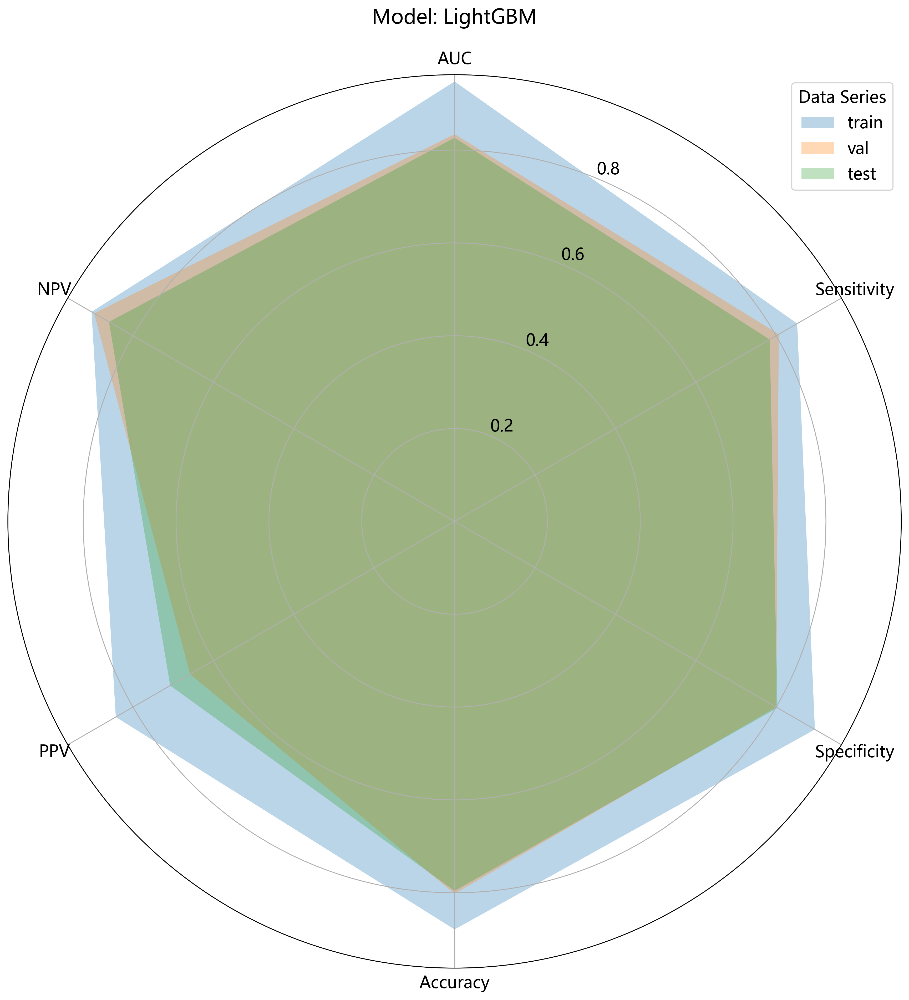

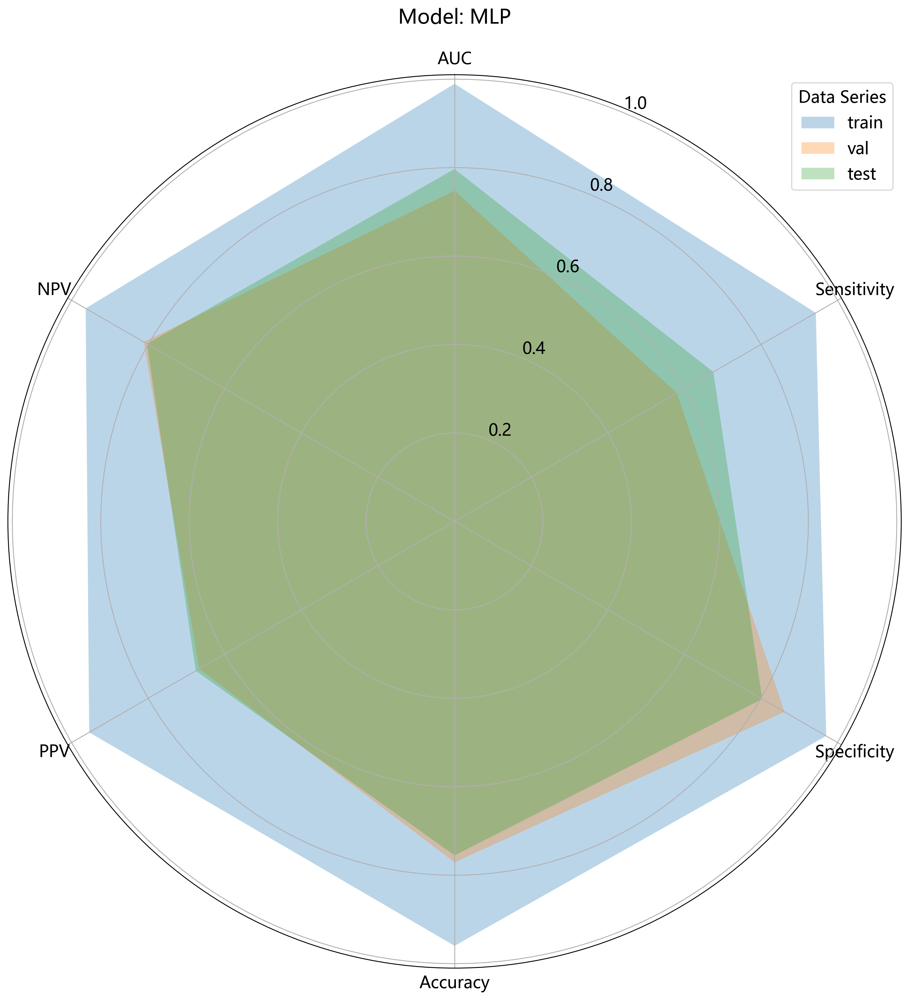

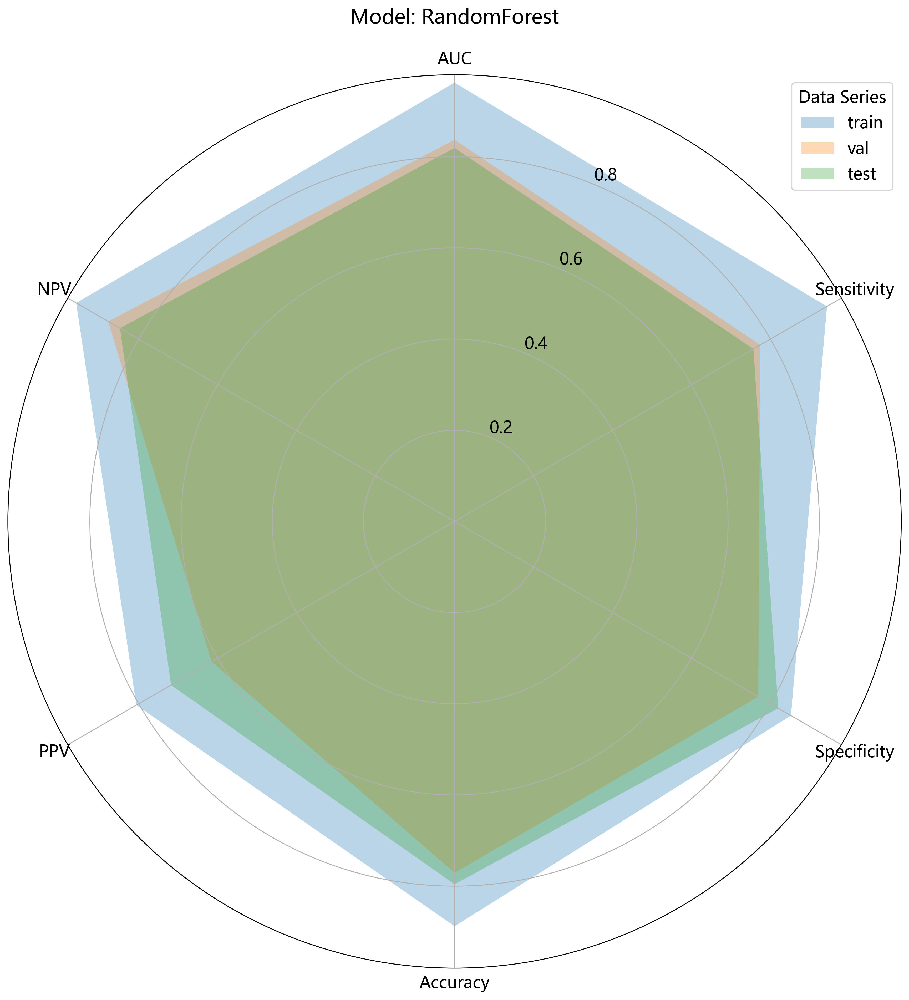

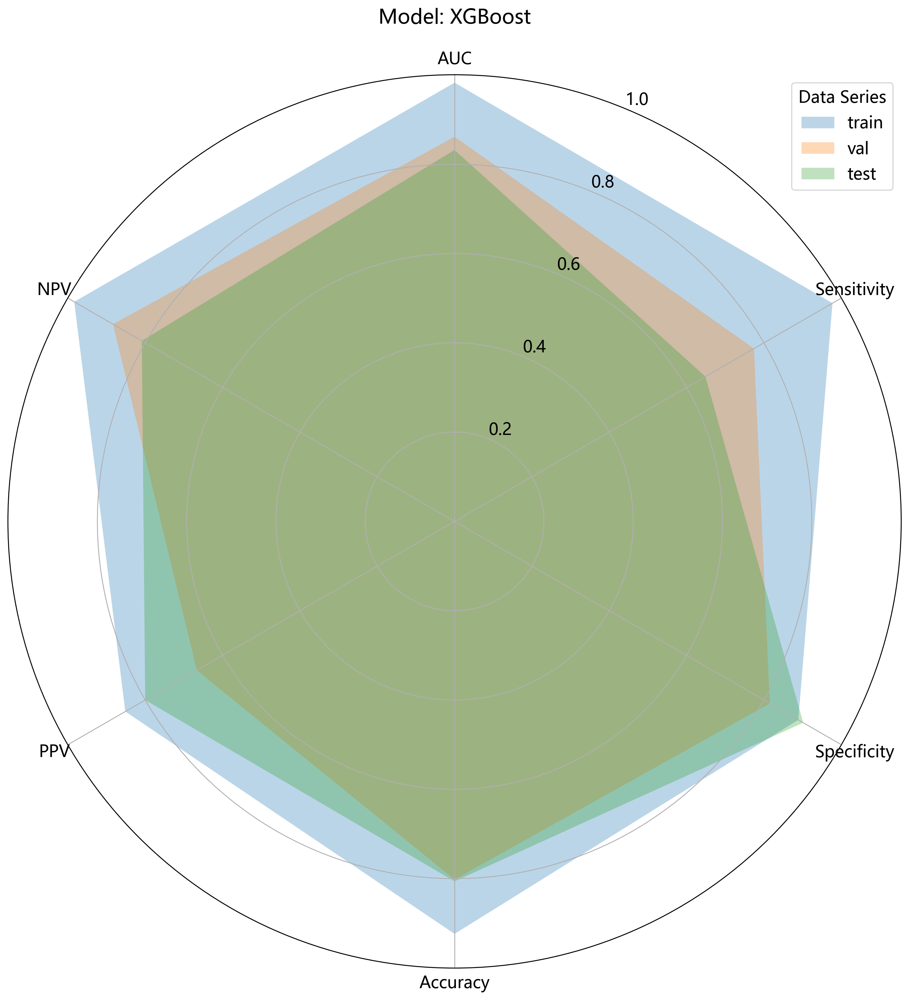

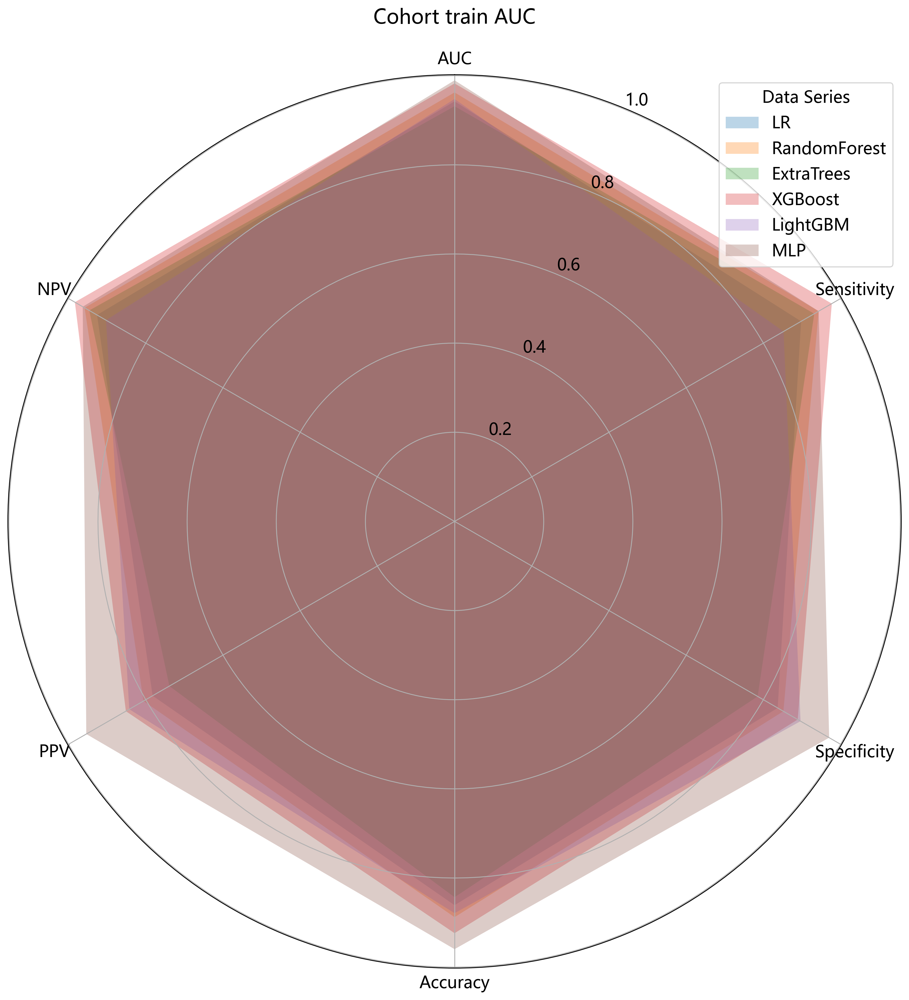

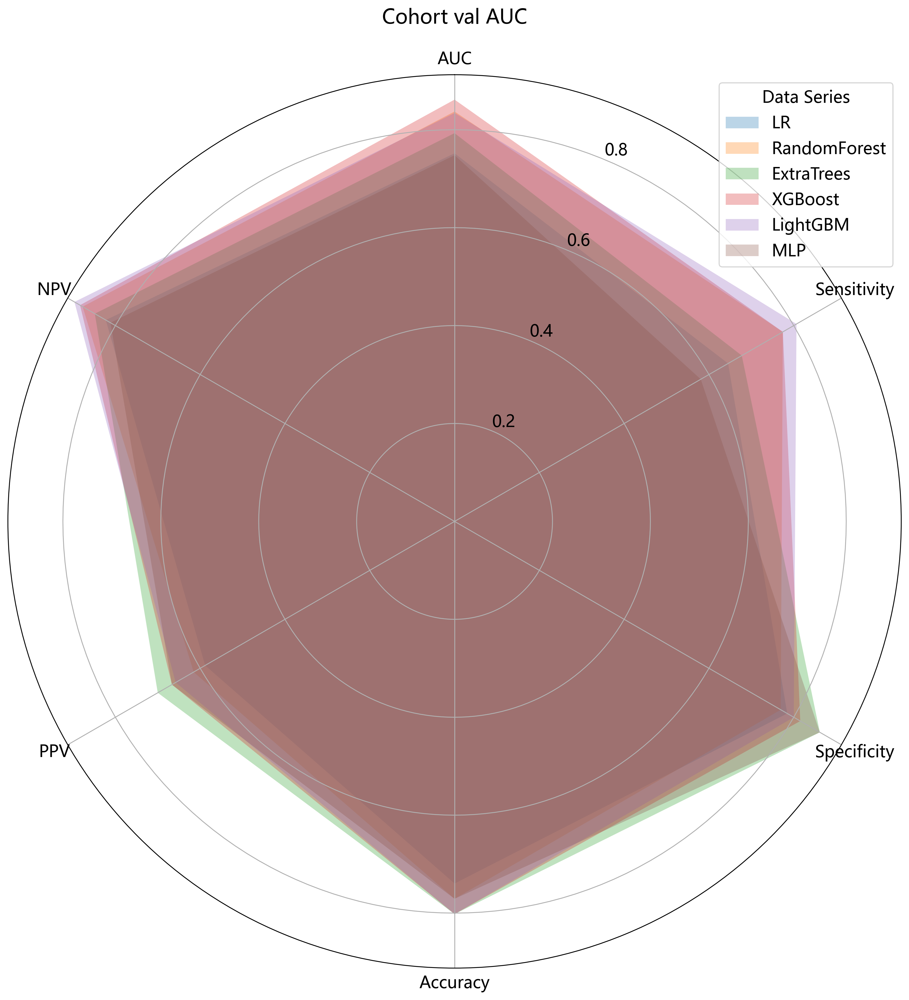

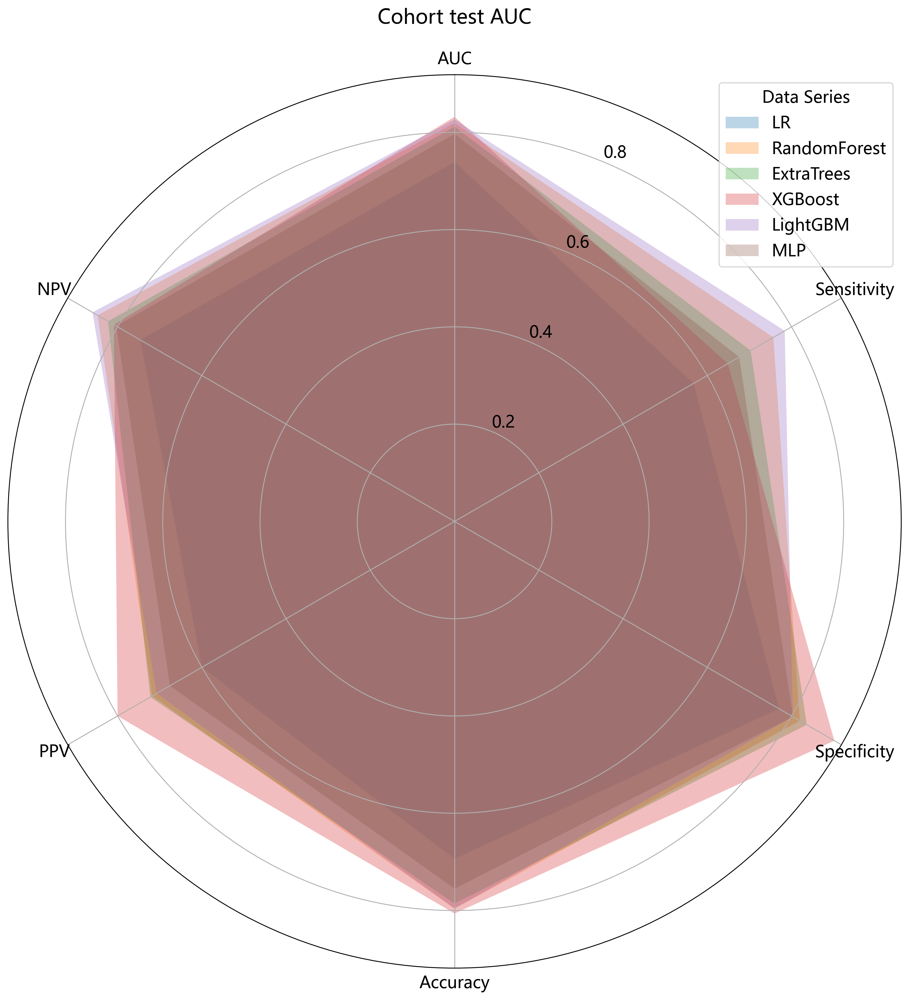

In [57]:
from onekey_algo.custom.components.comp1 import plot_radar

# 分模型输出
for model_name in np.unique(metric['model_name']):
    sub_metric = metric[metric['model_name'] == model_name]
    series_cols = sub_metric['Cohort']
    sub_metric = sub_metric[['AUC', 'Sensitivity', 'Specificity', 'Accuracy', 'PPV', 'NPV']].T
    sub_metric.columns = series_cols
#     display(sub_metric.reset_index())
    plot_radar(sub_metric.reset_index(), categories_col='index', series_cols=series_cols, figsize=(15,15), alpha=0.3,
               title=f'Model: {model_name}')
    plt.savefig(f'img/{task_type}model_{model_name}_metrics.svg', bbox_inches = 'tight')
    plt.show()

# 分数据集输出
for subset in ['train'] + list(val_datasets.keys()):
    sub_metric = metric[metric['Cohort'] == subset]
    series_cols = sub_metric['model_name']
    sub_metric = sub_metric[['AUC', 'Sensitivity', 'Specificity', 'Accuracy', 'PPV', 'NPV']].T
    sub_metric.columns = series_cols
#     display(sub_metric.reset_index())
    plot_radar(sub_metric.reset_index(), categories_col='index', series_cols=series_cols, alpha=0.3,
               title=f"Cohort {subset} AUC", figsize=(15,15))
    plt.savefig(f'img/{task_type}model_{subset}_metrics.svg', bbox_inches = 'tight')
    plt.show()

### 绘制曲线

绘制的不同模型的准确率柱状图和折线图曲线。

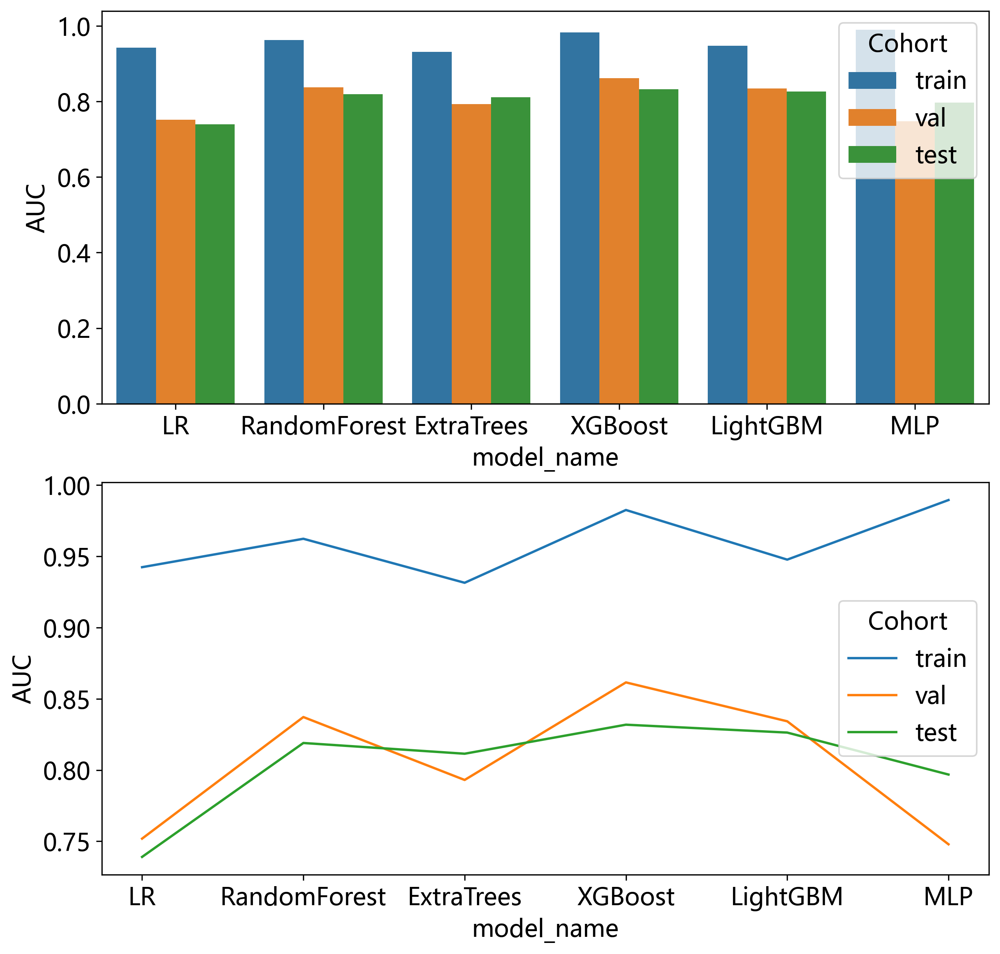

In [58]:
import seaborn as sns

plt.figure(figsize=(10, 10))
plt.subplot(211)
sns.barplot(x='model_name', y='AUC', data=metric, hue='Cohort')
plt.subplot(212)
sns.lineplot(x='model_name', y='AUC', data=metric, hue='Cohort')
plt.savefig(f'img/{task_type}model_acc.svg', bbox_inches = 'tight')

### 绘制ROC曲线
确定最好的模型，并且绘制曲线。

```python
def draw_roc(y_test, y_score, title='ROC', labels=None):
```

`sel_model = ['SVM', 'KNN']`参数为想要绘制的模型对应的参数。

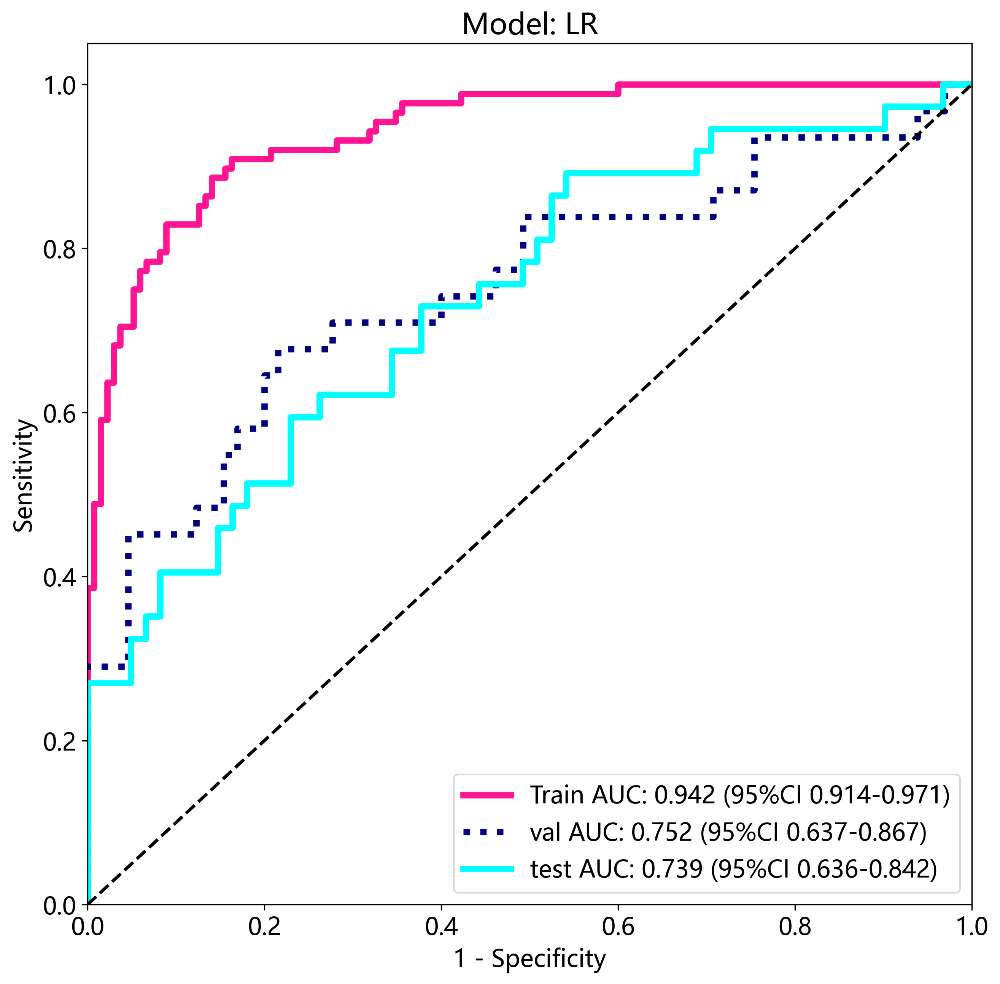

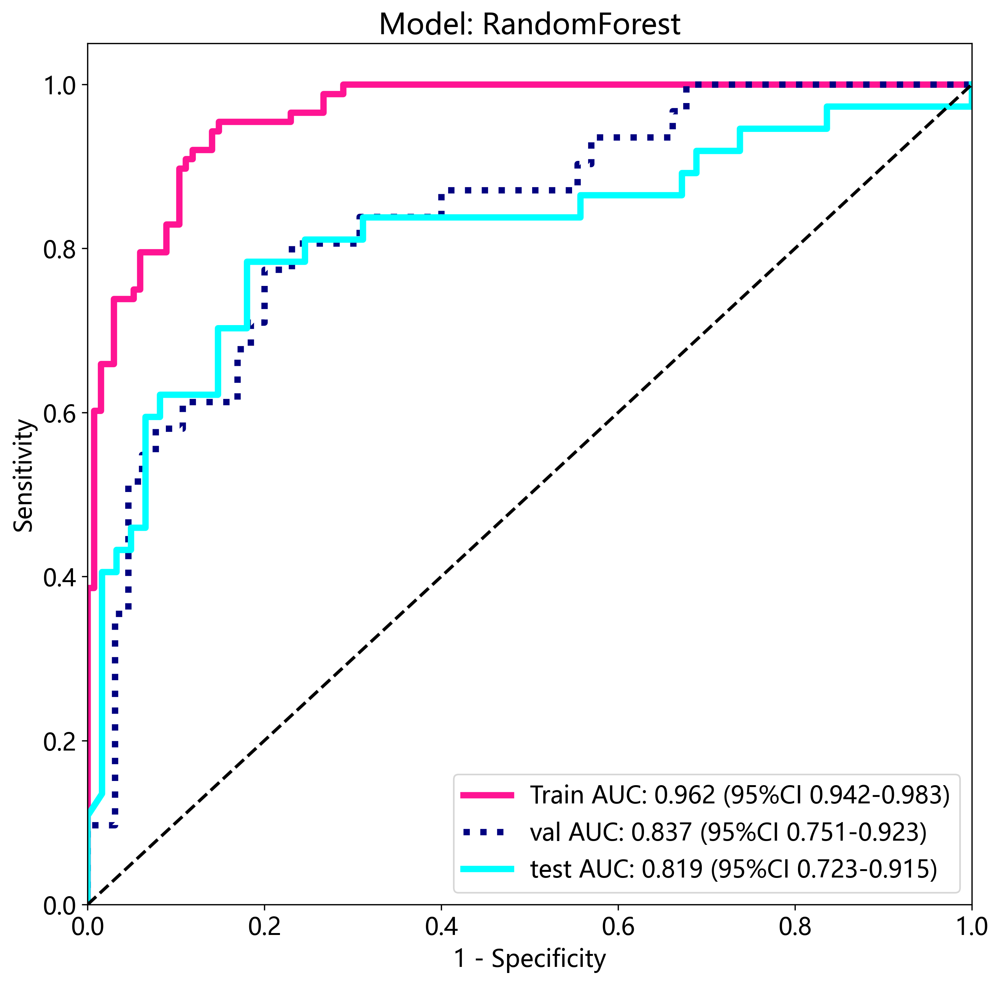

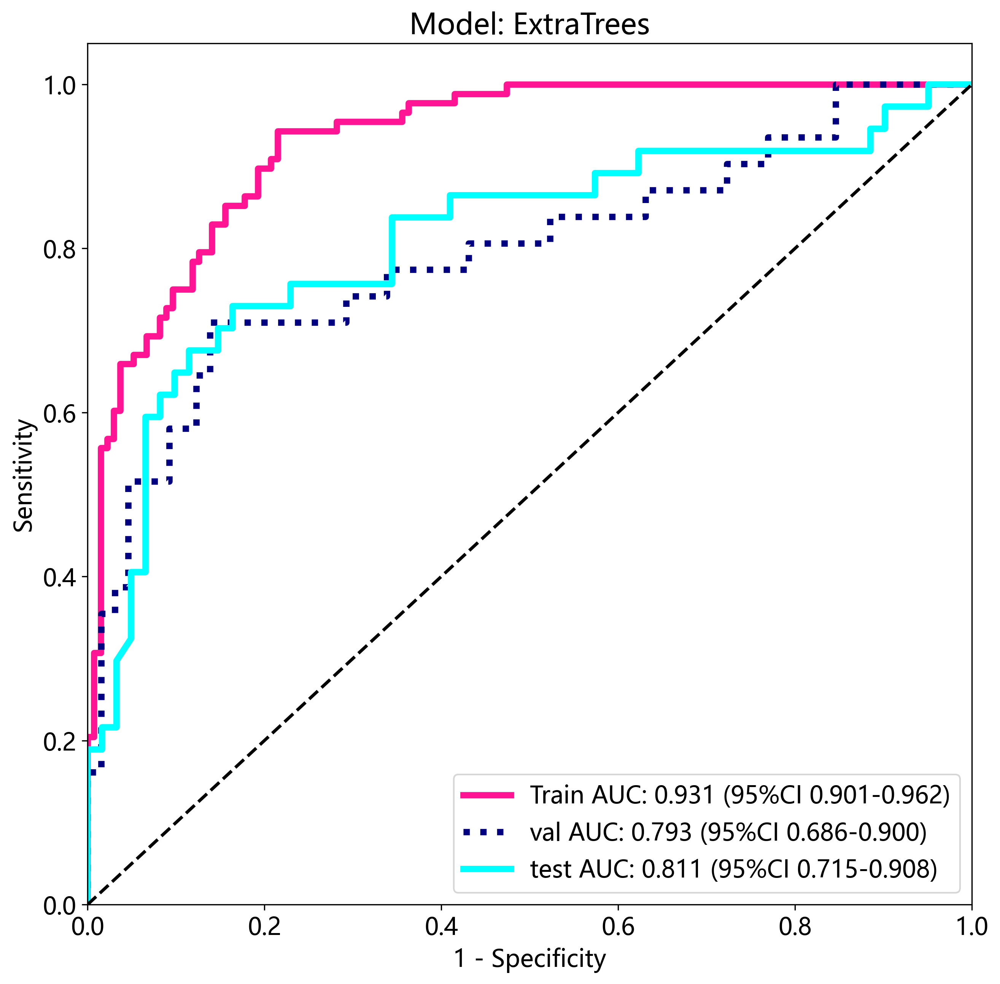

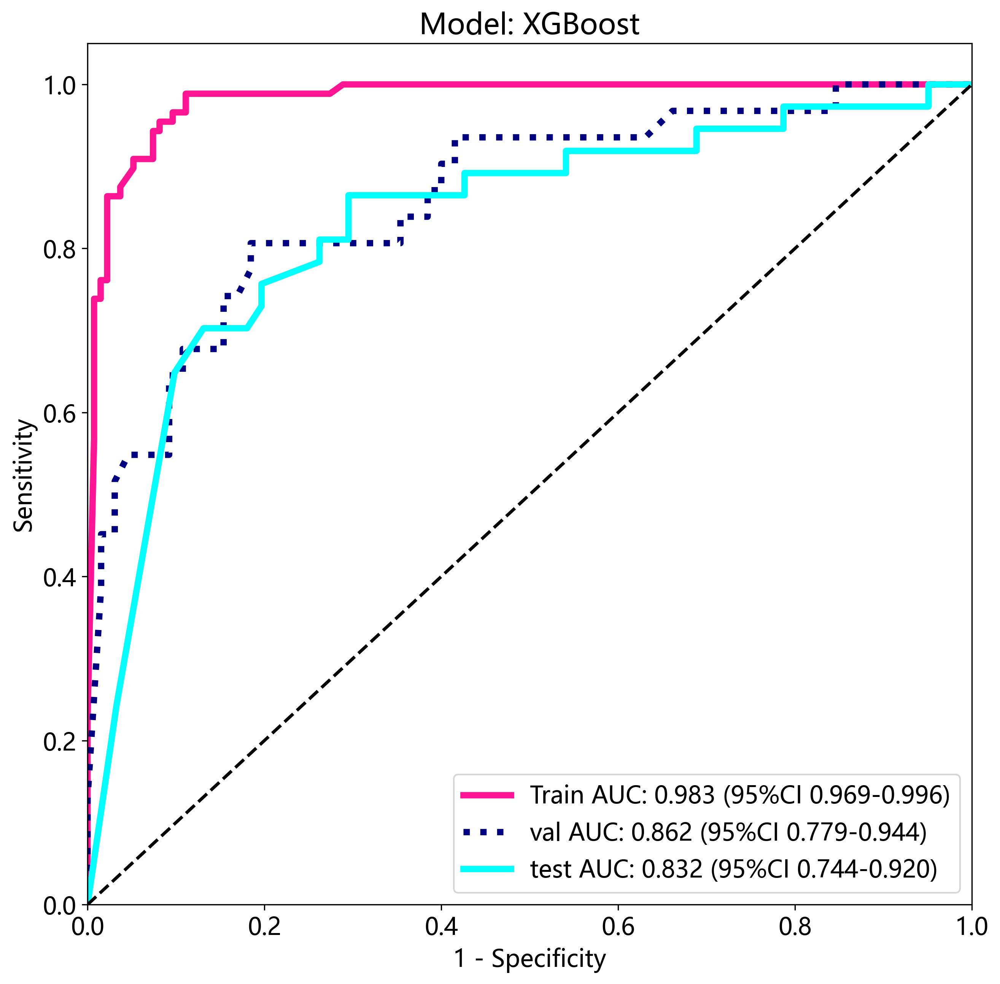

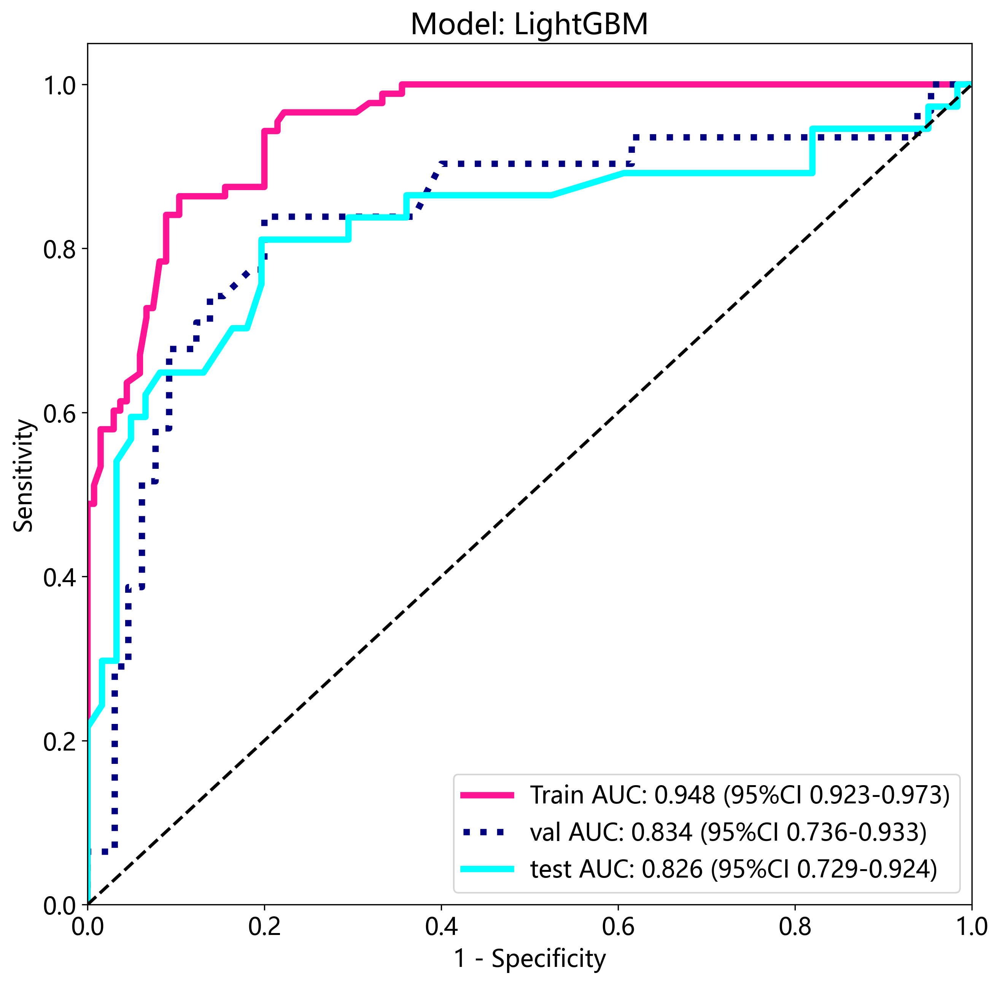

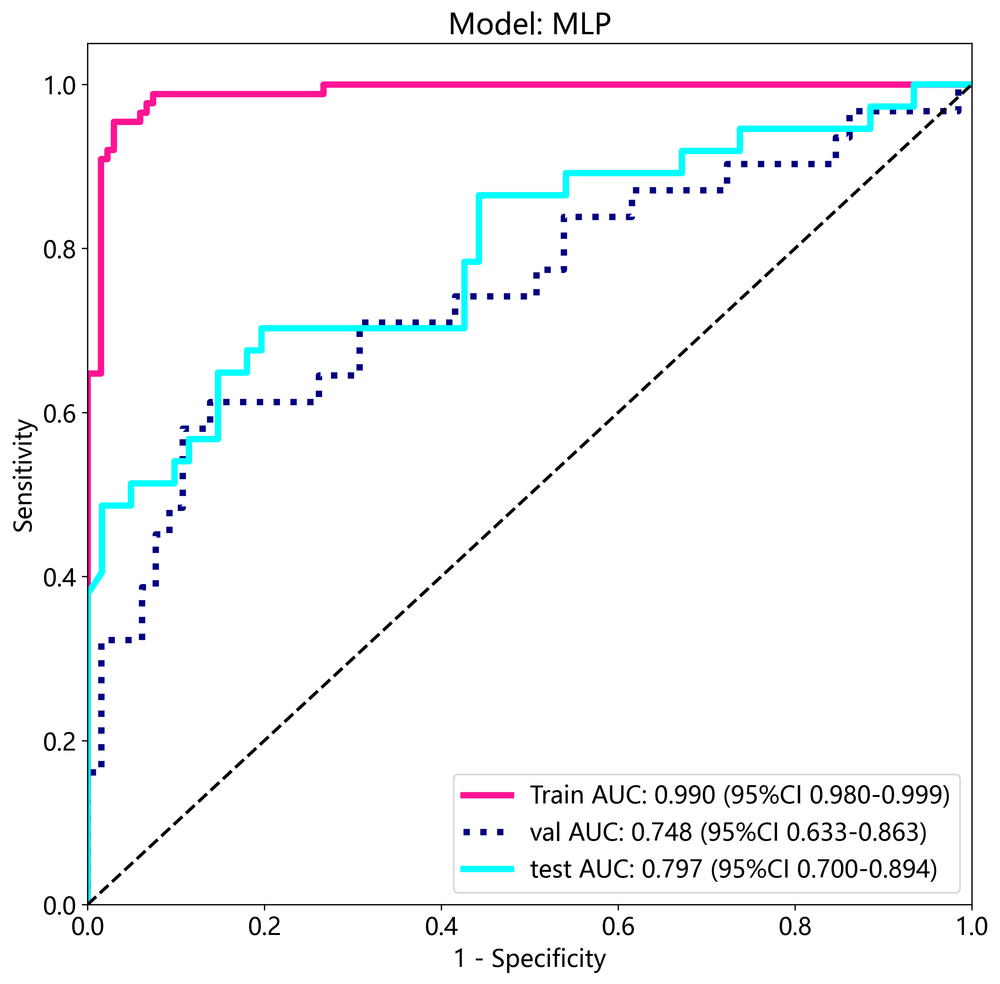

In [59]:
sel_model = model_names

for sm in sel_model:
    if sm in model_names:
        sel_model_idx = model_names.index(sm)
    
        # Plot all ROC curves
        plt.figure(figsize=(10, 10))
        for pred_score, label in zip(pred_scores, labels):
            ys = [np.array(y_train_sel[label])] + [np.array(y_val_sel[label]) for _, y_val_sel, _ in val_datasets.values()]
            ps = [pred_score[sel_model_idx][0]] + [p_[0] for p_ in pred_score[sel_model_idx][1]]
            okcomp.comp1.draw_roc(ys, ps, 
                                  labels=['Train'] + list(val_datasets.keys()), title=f"Model: {sm}")
            plt.savefig(f'img/{task_type}model_{sm}_roc.svg', bbox_inches = 'tight')
            plt.show()

#### 汇总所有模型

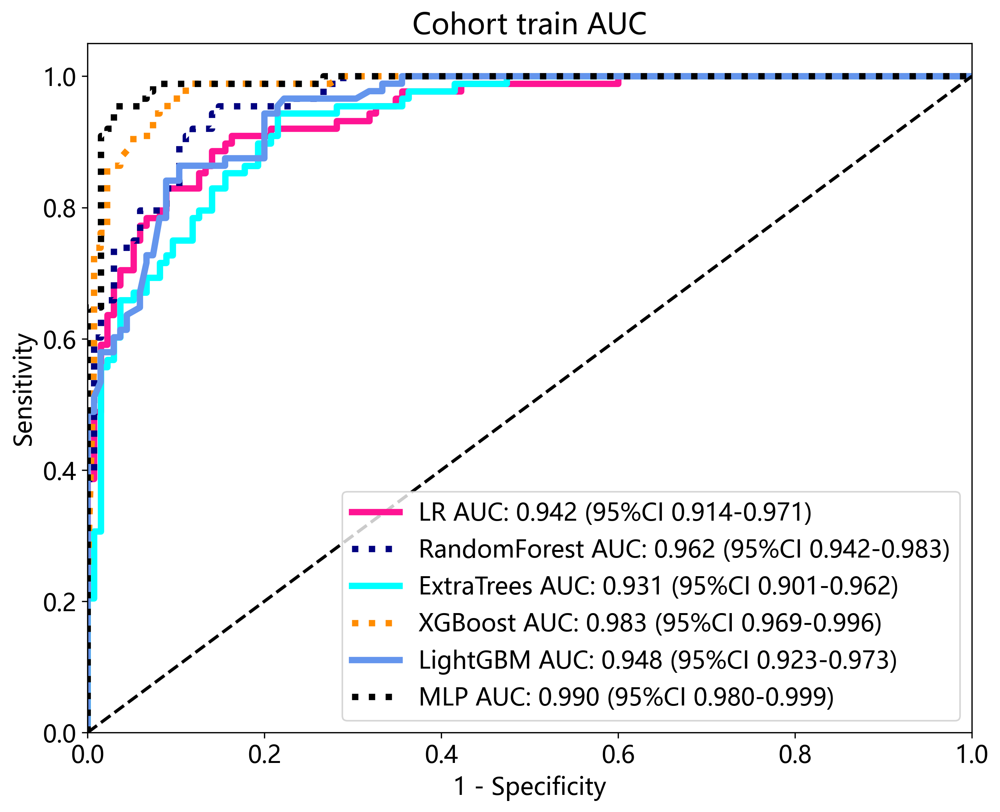

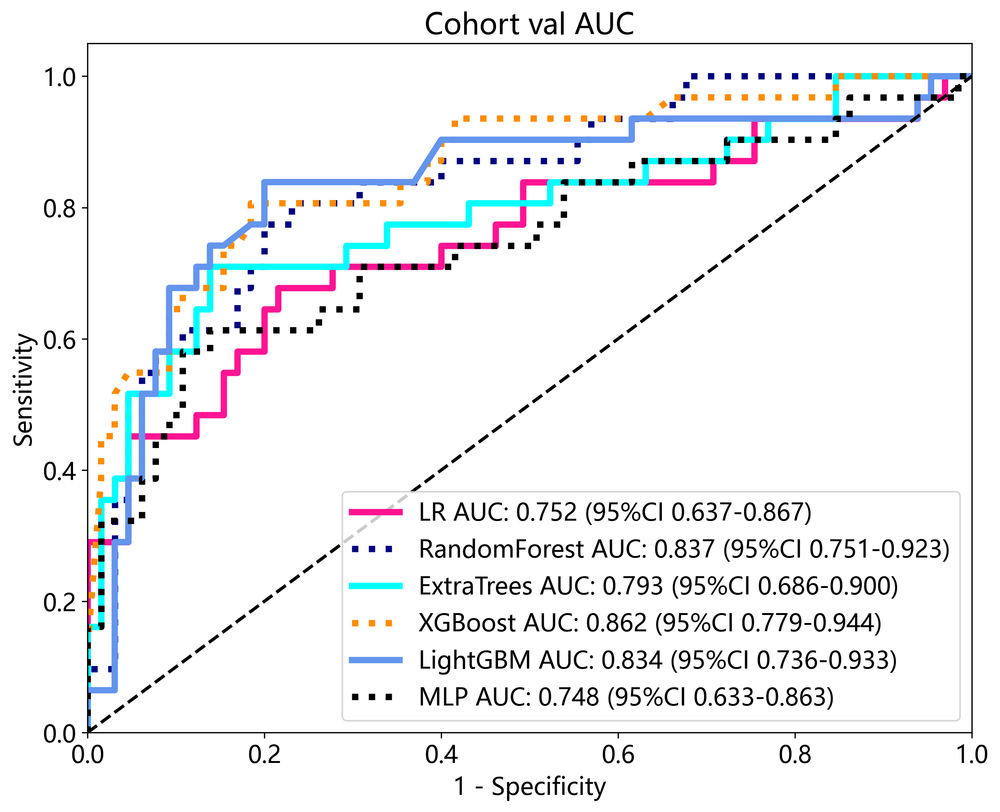

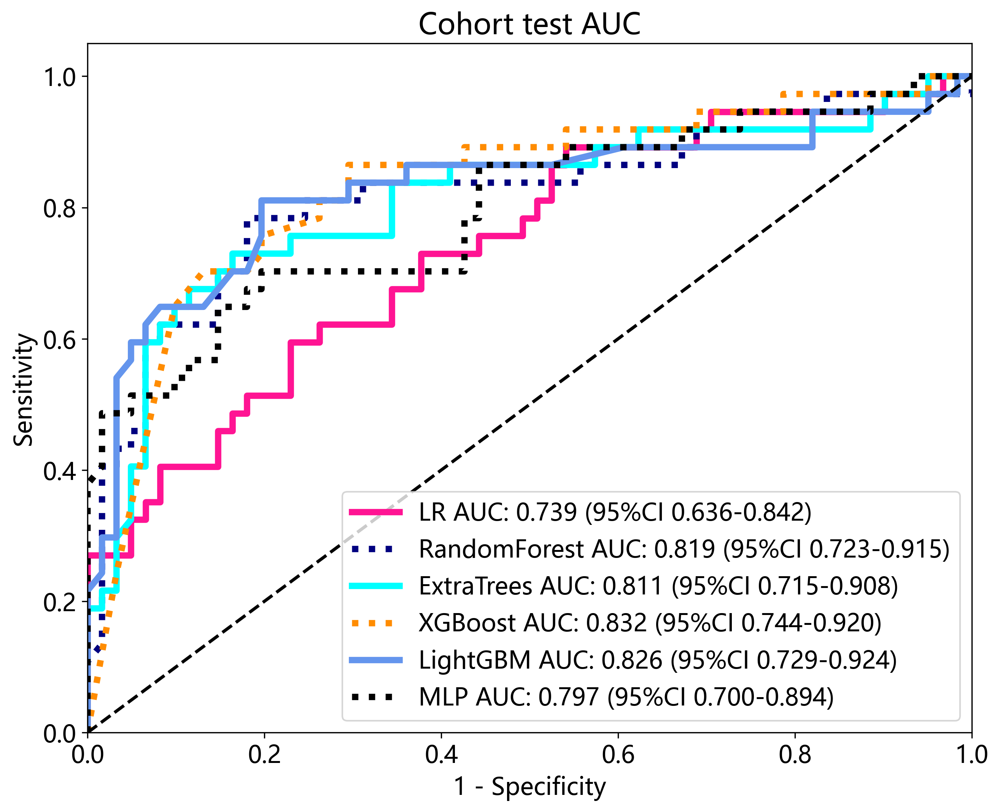

In [60]:
sel_model = model_names

for pred_score, label in zip(pred_scores, labels):
    pred_val_scores = []
    for sm in sel_model:
        if sm in model_names:
            sel_model_idx = model_names.index(sm)
            pred_val_scores.append((pred_score[sel_model_idx][0], y_train_sel))
    p_, l_ = zip(*pred_val_scores)
    okcomp.comp1.draw_roc(l_, p_, labels=sel_model, title=f"Cohort train AUC")
    plt.savefig(f'img/{task_type}model_train_roc.svg', bbox_inches = 'tight')
    plt.show()
    for sel_subset_idx, subset in enumerate(val_datasets.keys()):
        pred_val_scores = []
        for sm in sel_model:
            if sm in model_names:
                sel_model_idx = model_names.index(sm)
                pred_val_scores.append(pred_score[sel_model_idx][1][sel_subset_idx])
        p_, l_ = zip(*pred_val_scores)
        okcomp.comp1.draw_roc(l_, p_, labels=sel_model, title=f"Cohort {subset} AUC")
        plt.savefig(f'img/{task_type}model_{subset}_roc.svg', bbox_inches = 'tight')
        plt.show()

### 绘制混淆矩阵

绘制混淆矩阵，[混淆矩阵解释](https://baike.baidu.com/item/%E6%B7%B7%E6%B7%86%E7%9F%A9%E9%98%B5/10087822?fr=aladdin)
`sel_model = ['SVM', 'KNN']`参数为想要绘制的模型对应的参数。

如果需要修改标签到名称的映射，修改`class_mapping={1:'1', 0:'0'}`

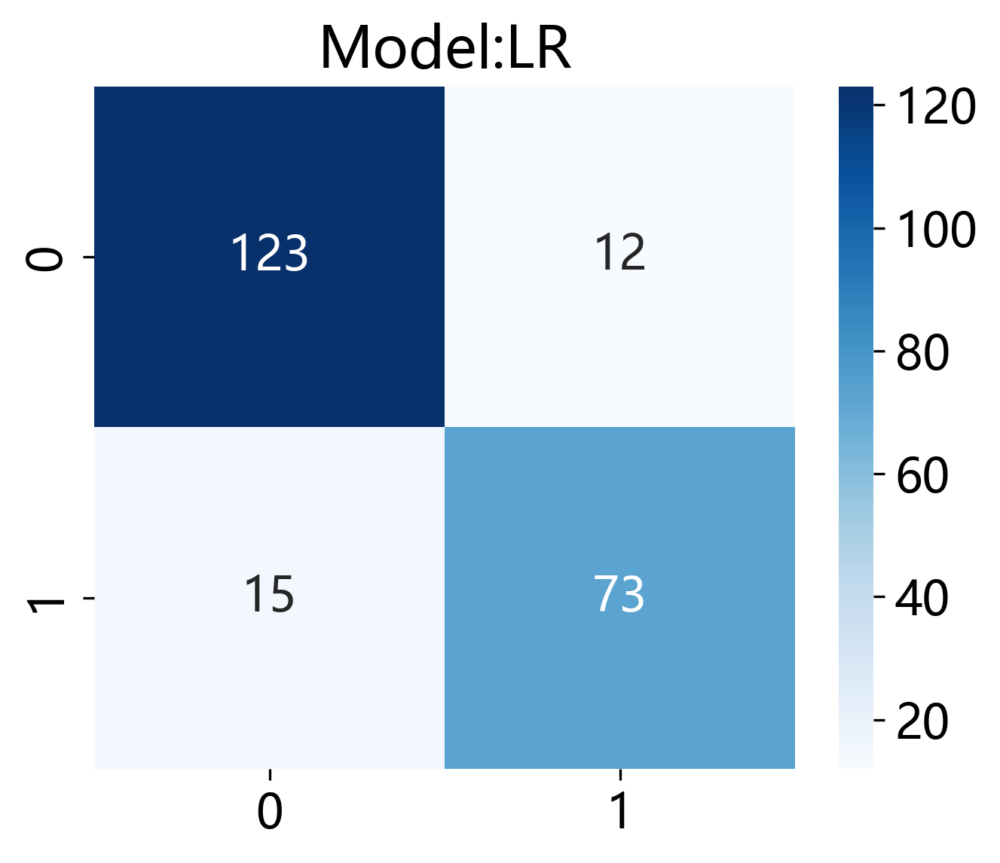

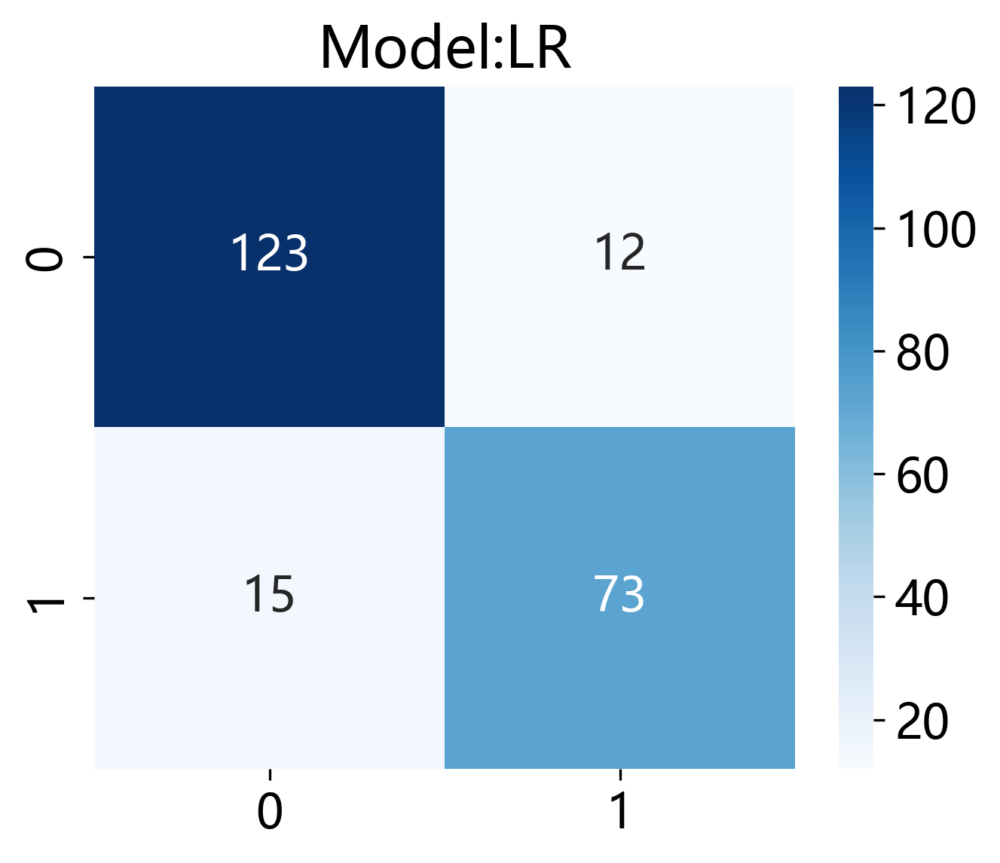

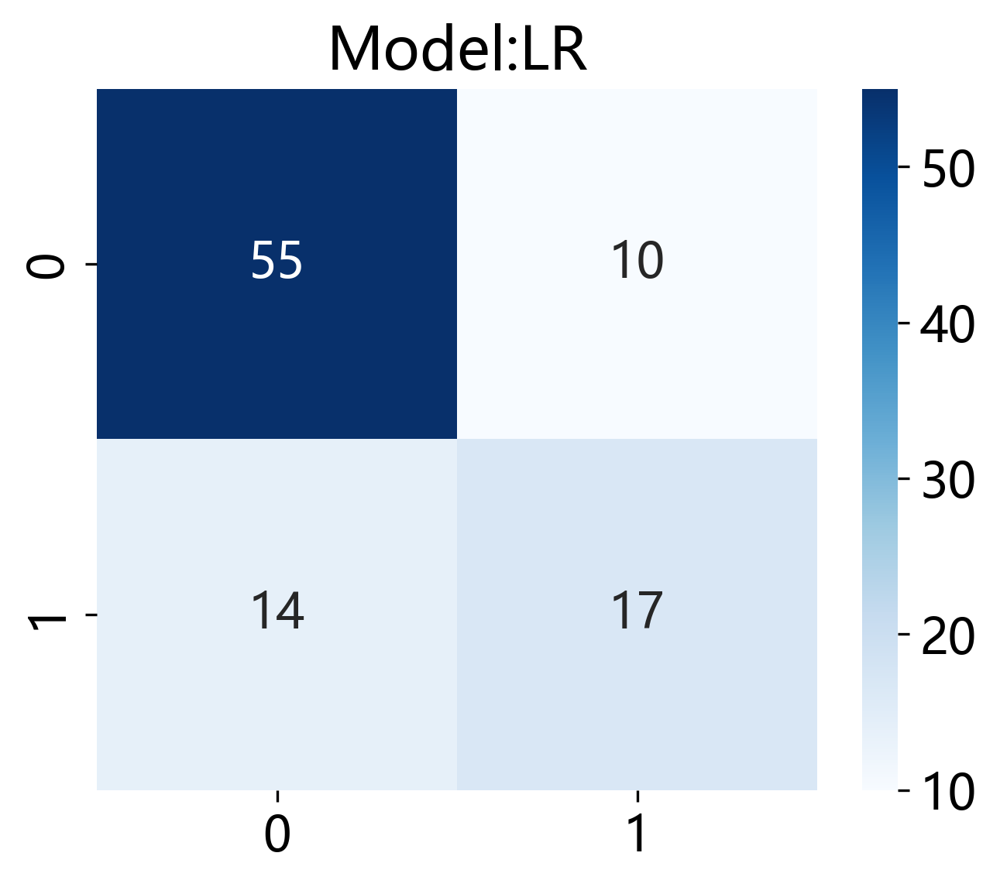

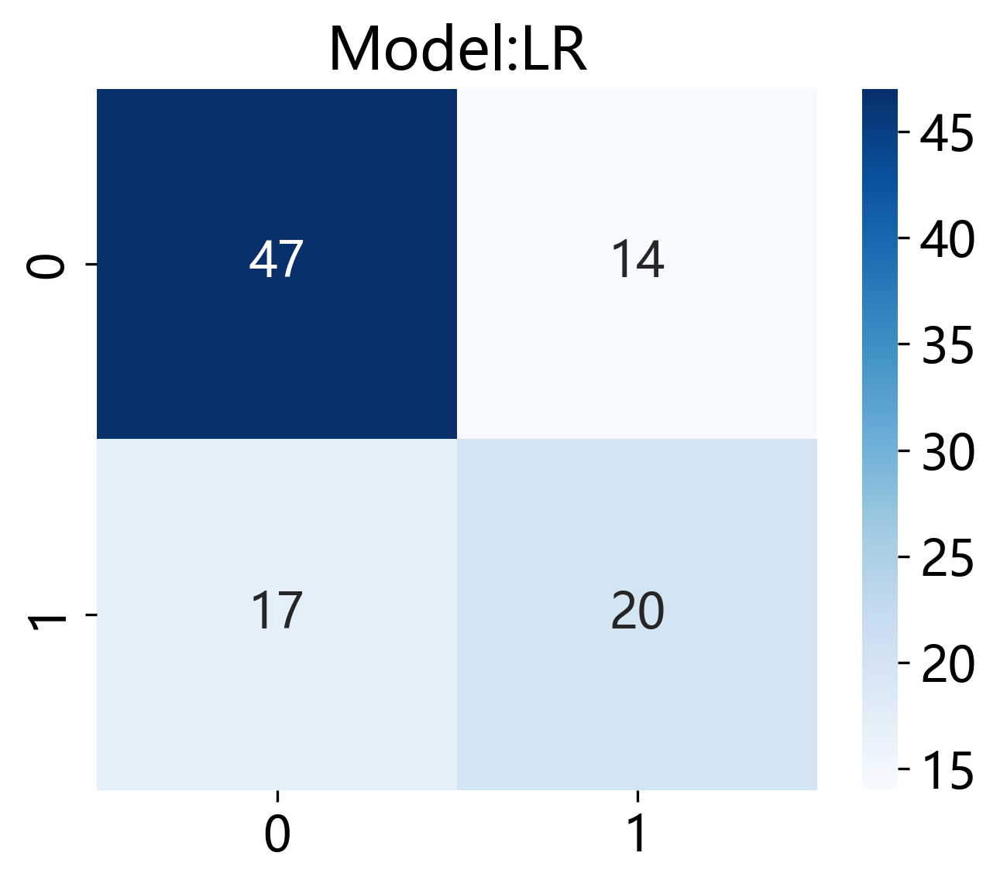

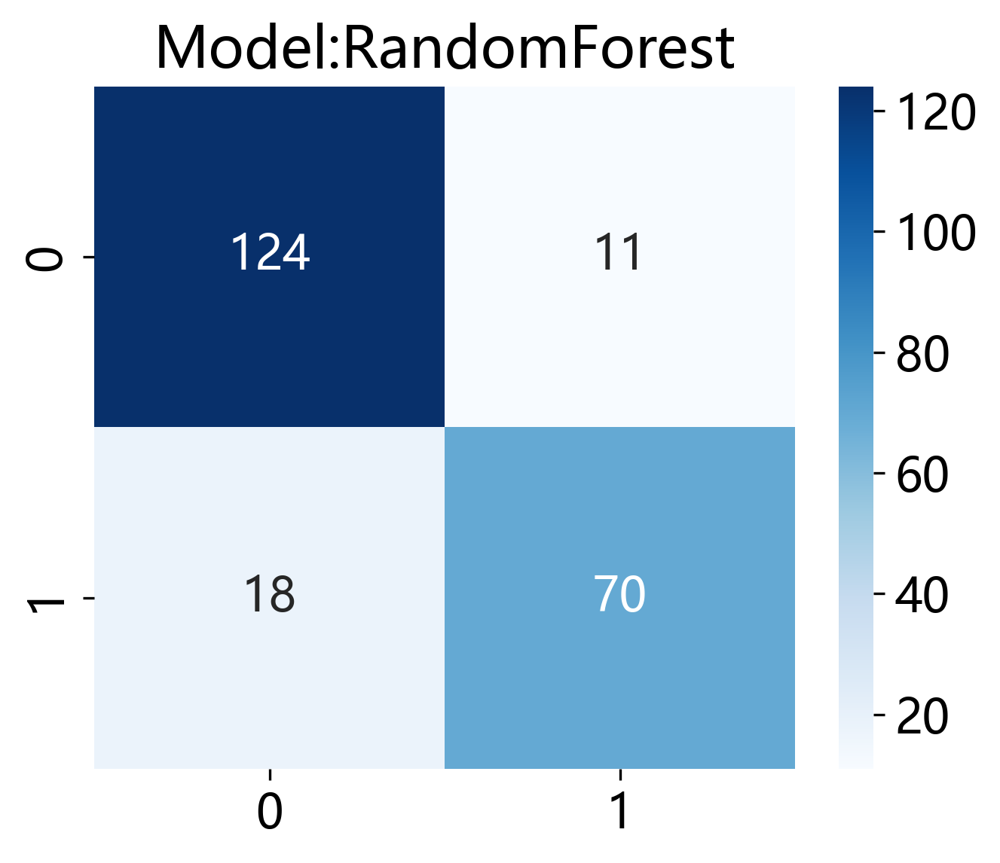

...

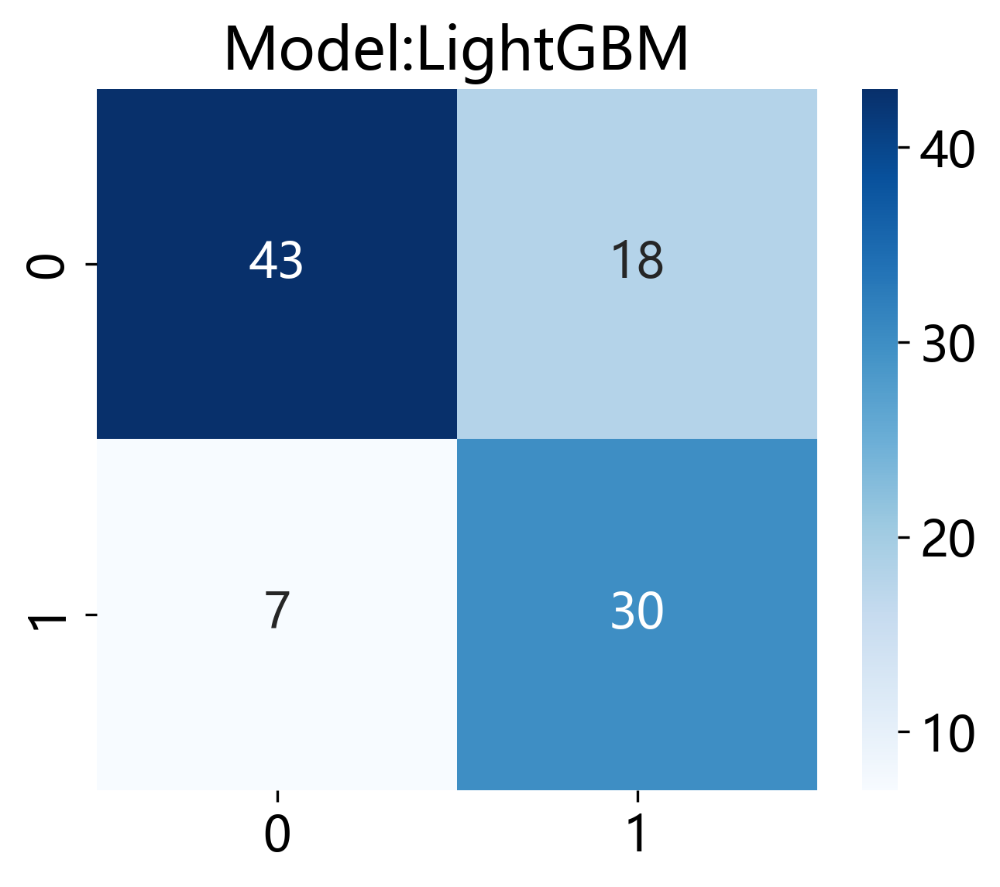

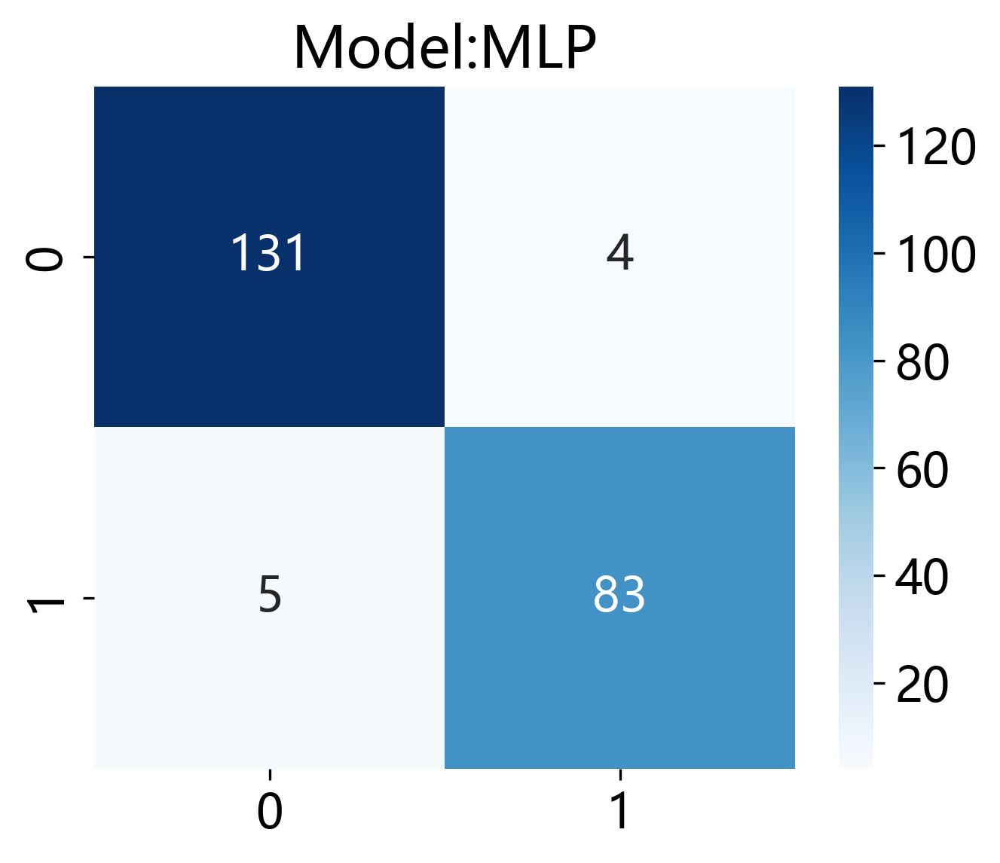

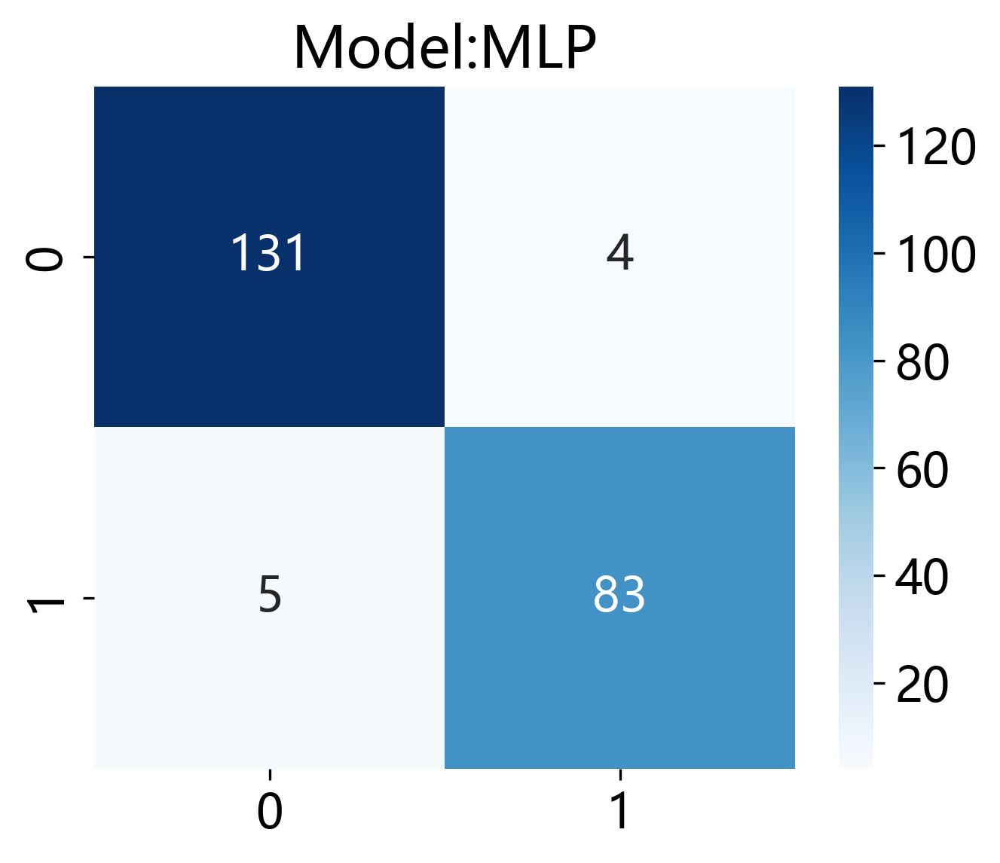

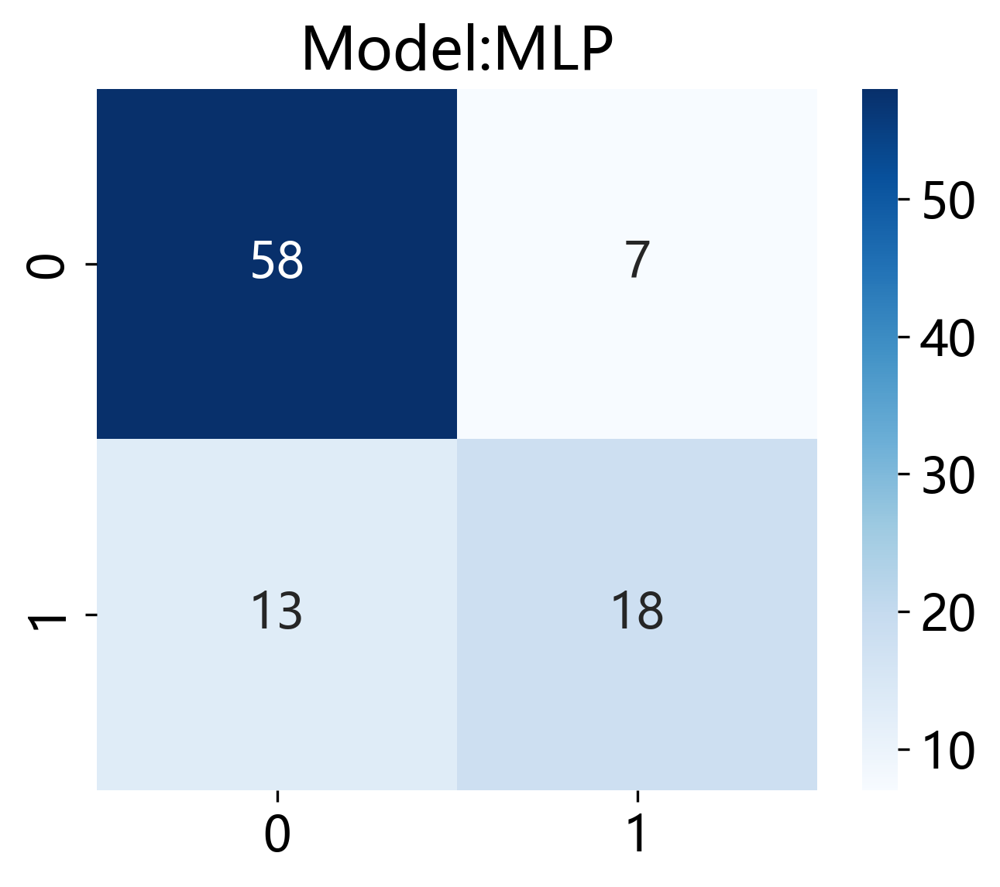

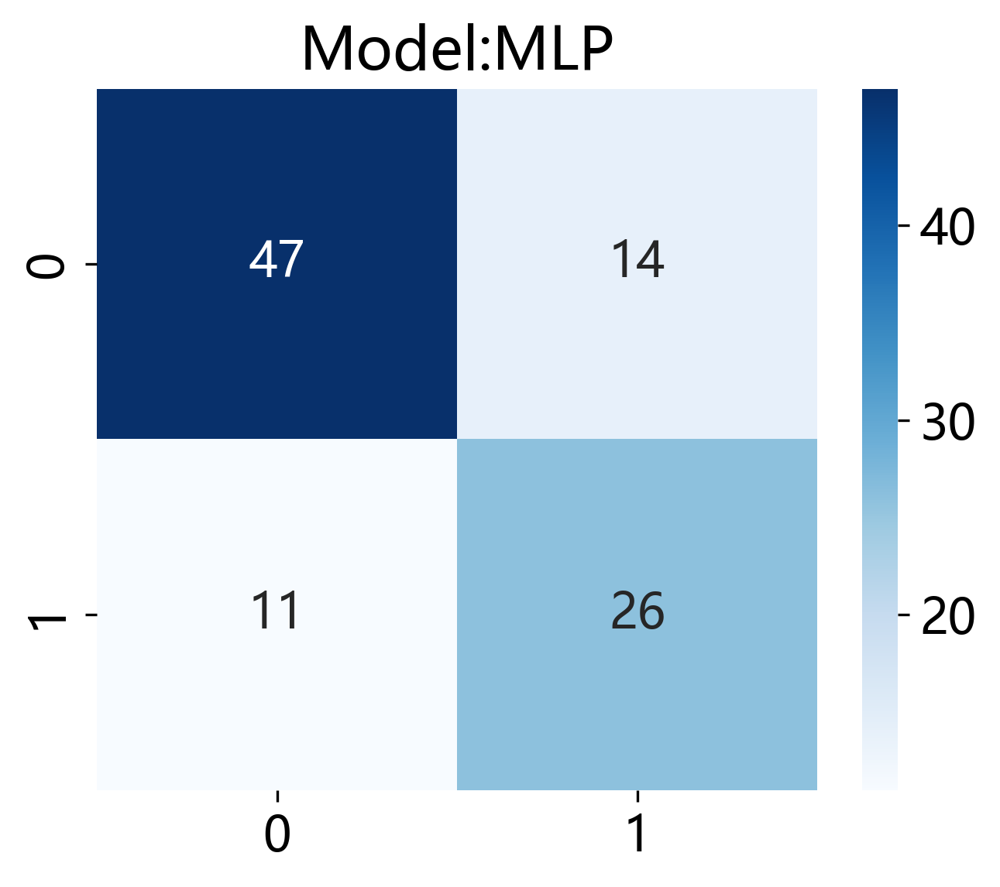

In [61]:
# 设置绘制参数
sel_model = model_names

mapping = dict(list(enumerate(get_param_in_cwd('mapping_keys'))))
for sm in sel_model:
    if sm in model_names:
        sel_model_idx = model_names.index(sm)
        for idx, label in enumerate(labels):
            for sel_subset_idx, subset in enumerate(val_datasets.keys()):
                p_ = predictions[idx][sel_model_idx][0]
                cm = okcomp.comp1.calc_confusion_matrix(p_, y_train_sel[label], 
                                                        class_mapping=mapping, num_classes=2)
                plt.figure(figsize=(5, 4))
                plt.title(f'Model:{sm}')
                okcomp.comp1.draw_matrix(cm, norm=False, annot=True, cmap='Blues', fmt='.0f')
                plt.savefig(f'img/{task_type}model_train_{sm}_cm.svg', bbox_inches = 'tight')
            for sel_subset_idx, subset in enumerate(val_datasets.keys()):
                p_, l_ = predictions[idx][sel_model_idx][1][sel_subset_idx]
                cm = okcomp.comp1.calc_confusion_matrix(p_, l_[label], 
                                                        class_mapping=mapping, num_classes=2)
                plt.figure(figsize=(5, 4))
                plt.title(f'Model:{sm}')
                okcomp.comp1.draw_matrix(cm, norm=False, annot=True, cmap='Blues', fmt='.0f')
                plt.savefig(f'img/{task_type}model_{subset}_{sm}_cm.svg', bbox_inches = 'tight')

### 样本预测直方图

绘制每个样本的预测结果以及对应的真实结果, 图例中label=xx可以修改成自己类别的真实标签。

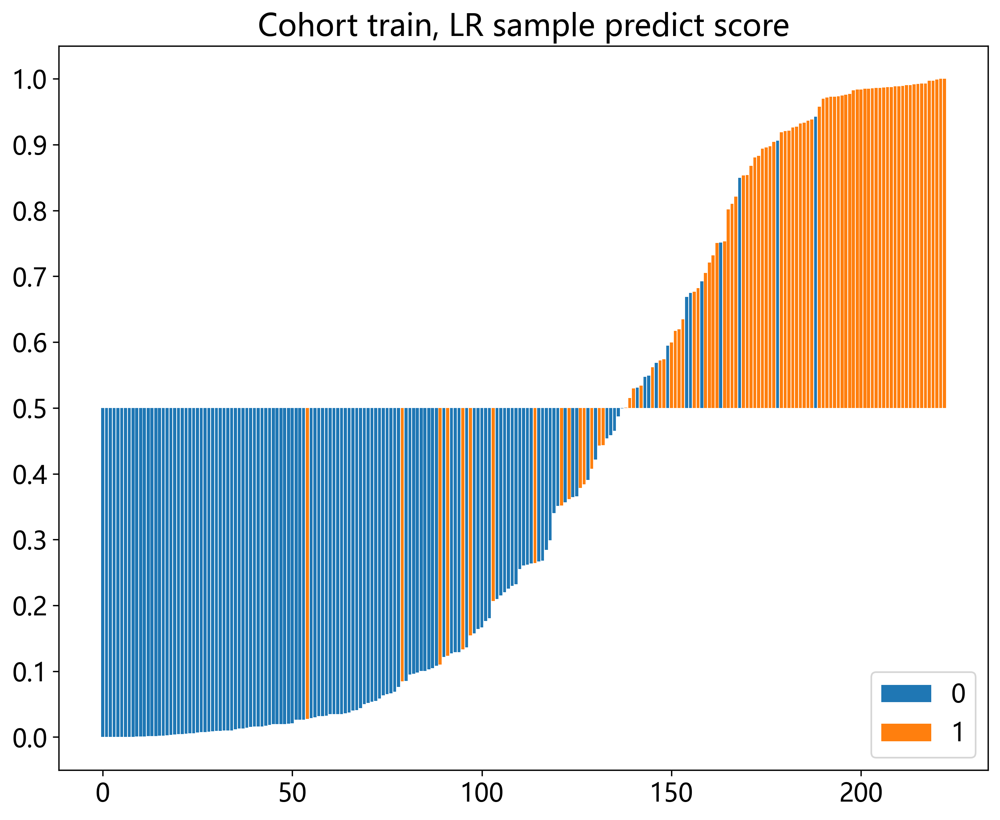

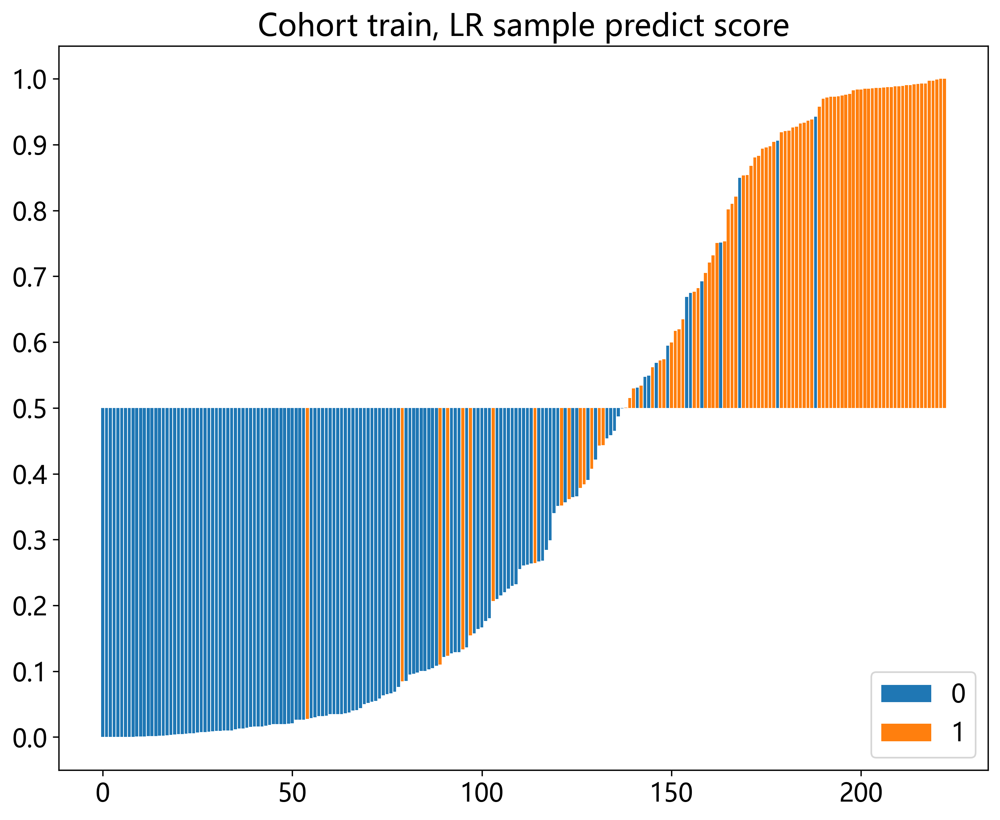

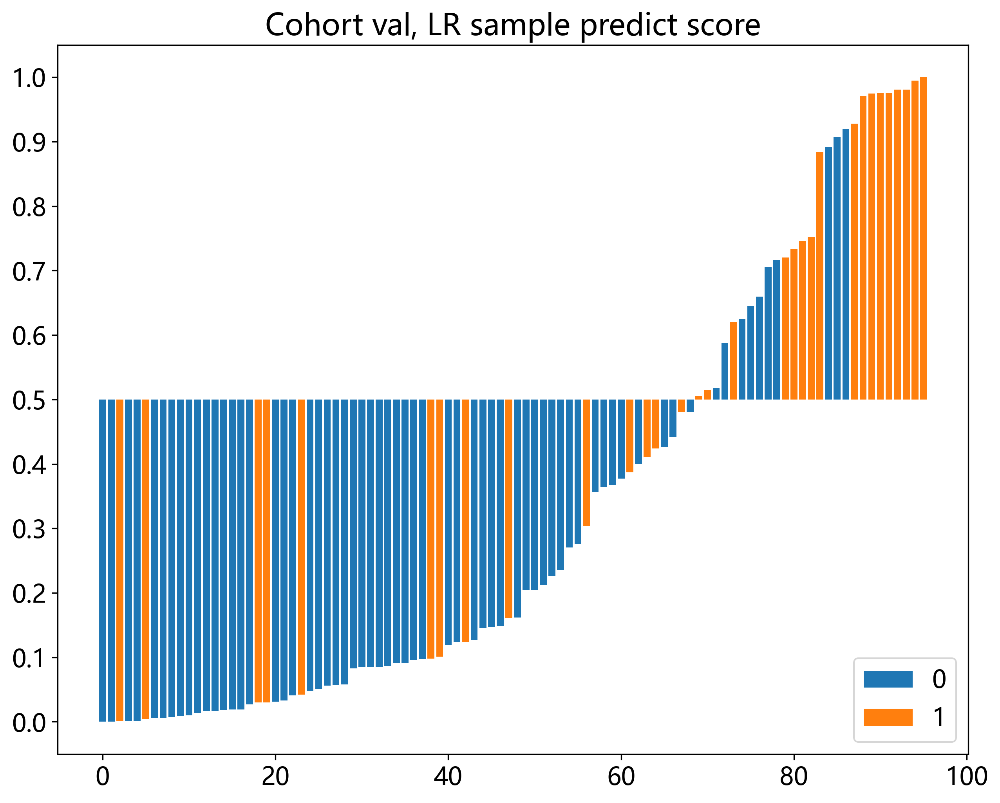

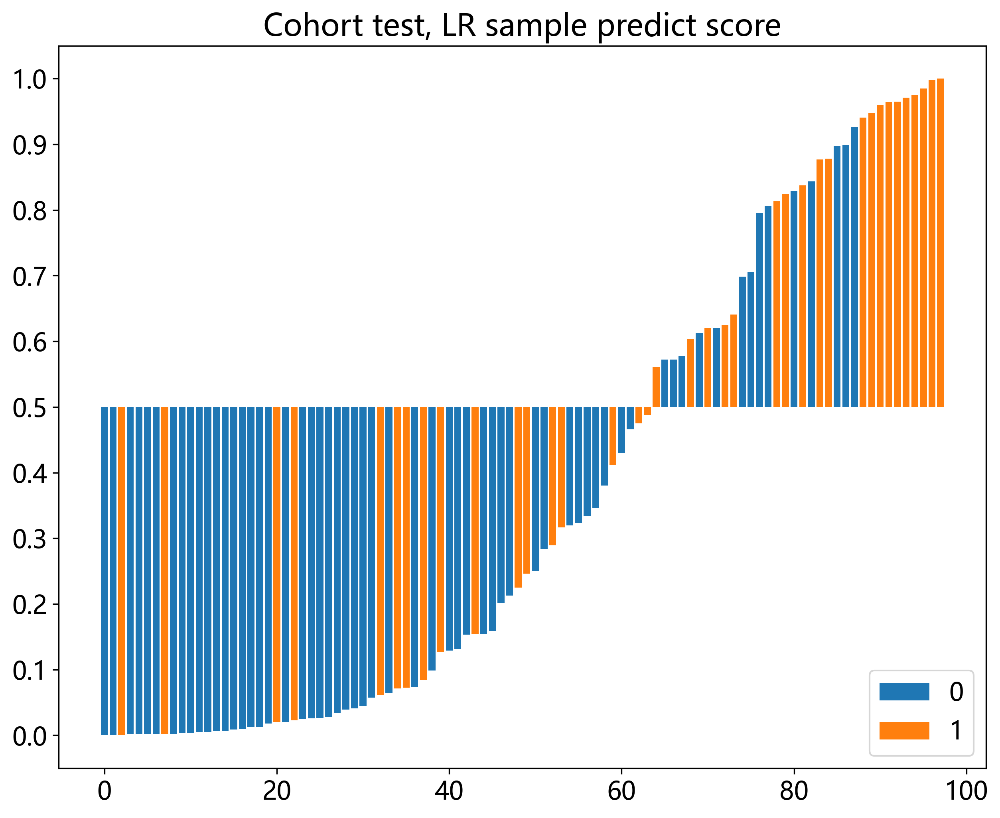

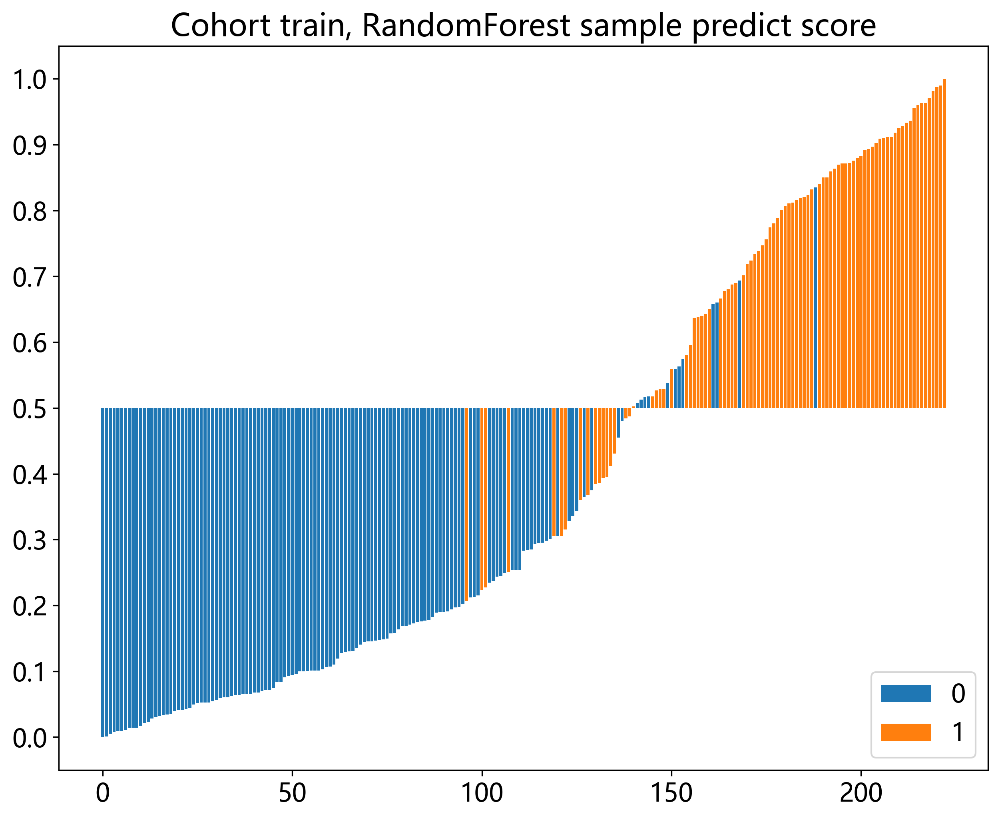

...

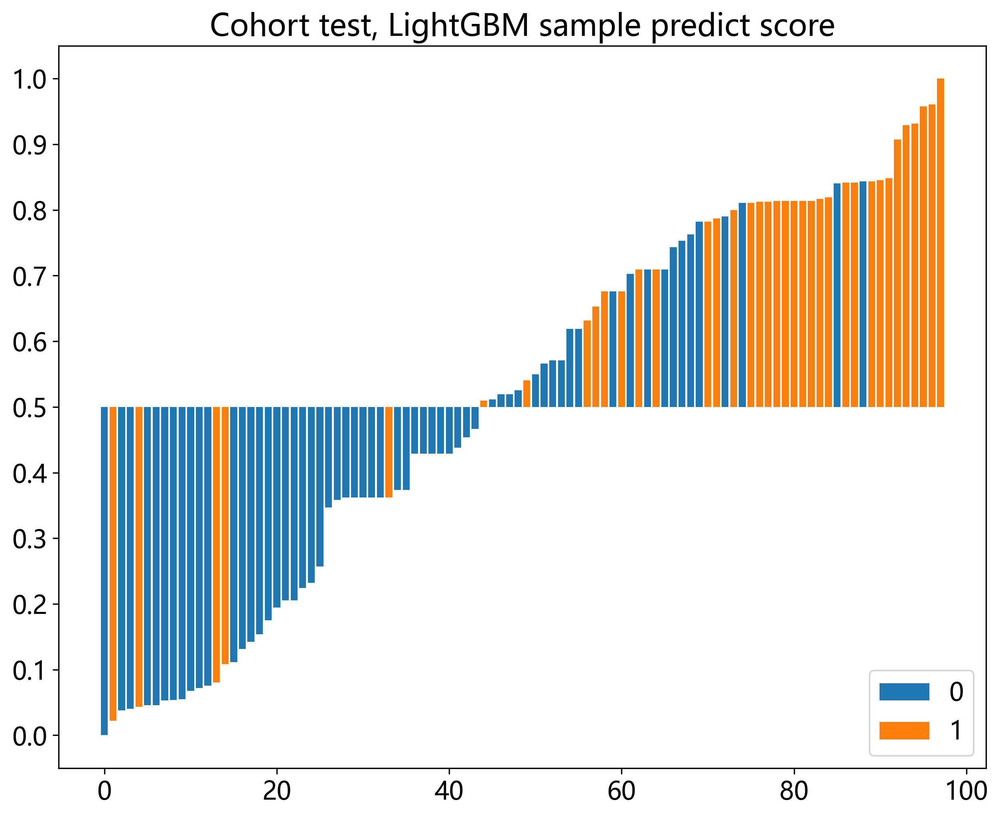

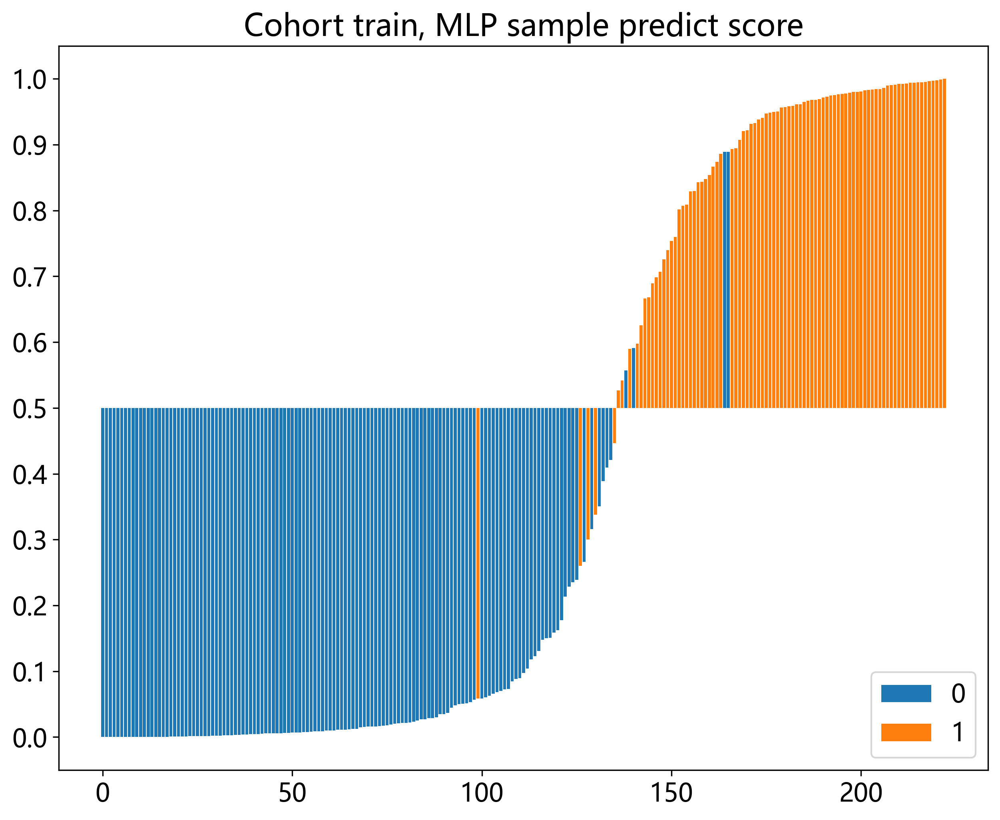

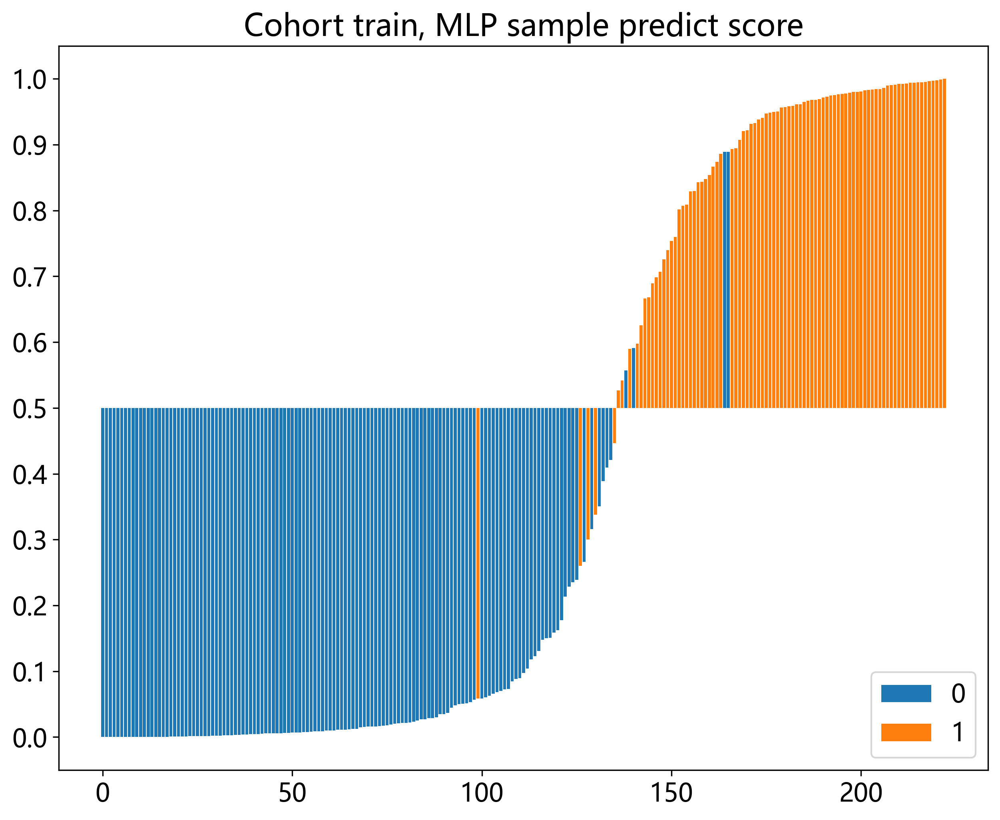

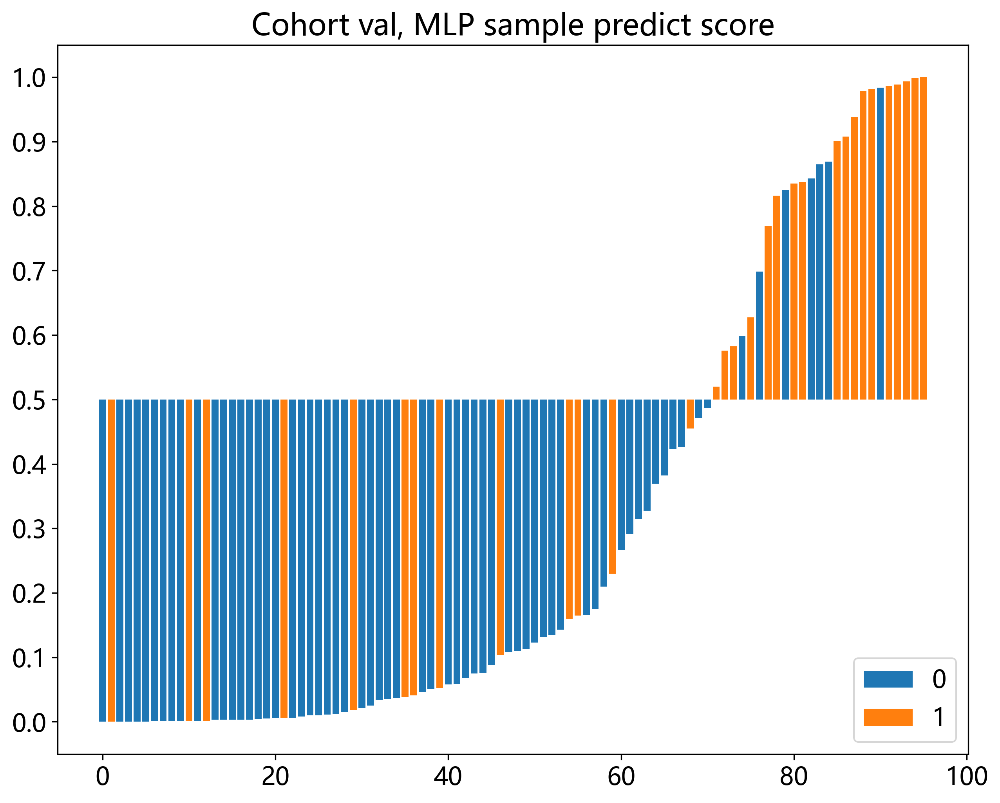

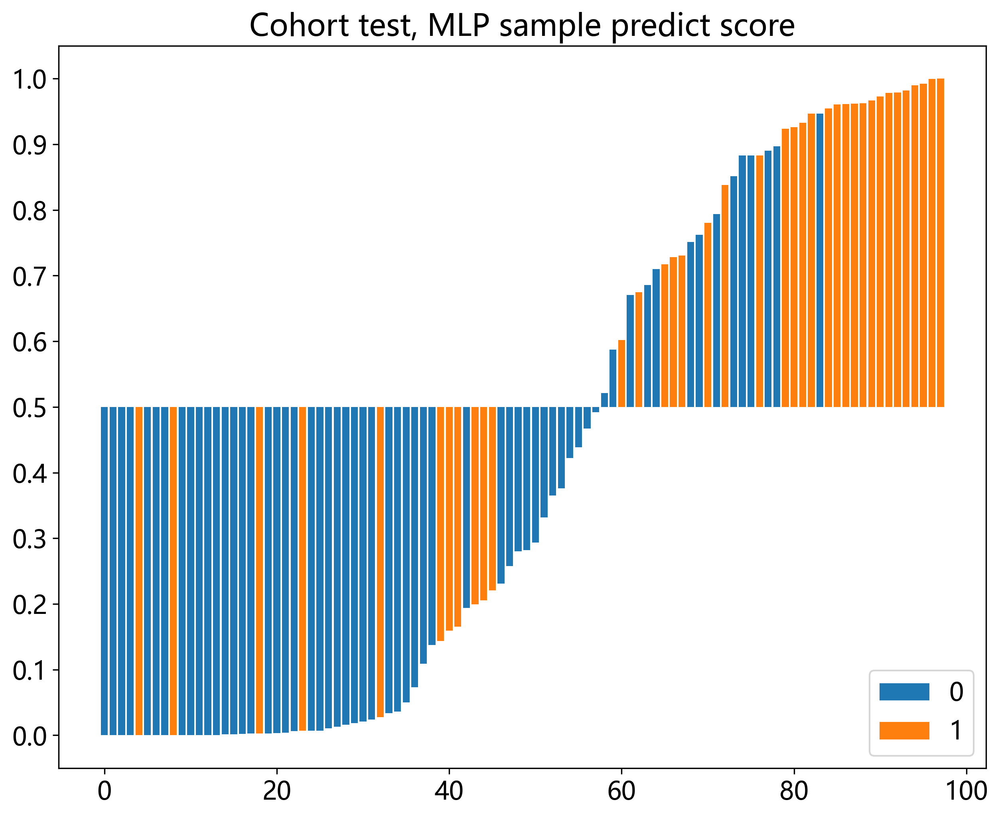

In [62]:
sel_model = model_names
c_matrix = {}

for sm in sel_model:
    if sm in model_names:
        sel_model_idx = model_names.index(sm)
        for idx, label in enumerate(labels):
            for sel_subset_idx, subset in enumerate(val_datasets.keys()):
                p_ = pred_scores[idx][sel_model_idx][0]
                okcomp.comp1.draw_predict_score(p_, y_train_sel[label],
                                                threshold=metric[(metric['Cohort'] == 'train') & (metric['model_name'] == sm)]['Threshold'])
                plt.title(f'Cohort train, {sm} sample predict score')
                plt.legend(labels=mapping.values(),loc="lower right") 
                plt.yticks([(i-5)/5 for i in range(11)], [i/10 for i in range(11)])
                plt.savefig(f'img/{task_type}train_{sm}_sample_dis.svg', bbox_inches = 'tight')
                plt.show()
            for sel_subset_idx, subset in enumerate(val_datasets.keys()):
                p_, l_ = pred_scores[idx][sel_model_idx][1][sel_subset_idx]
                okcomp.comp1.draw_predict_score(p_, l_[label],
                                                threshold=metric[(metric['Cohort'] == subset) & (metric['model_name'] == sm)]['Threshold'])
                plt.title(f'Cohort {subset}, {sm} sample predict score')
                plt.legend(labels=mapping.values(),loc="lower right") 
                plt.yticks([(i-5)/5 for i in range(11)], [i/10 for i in range(11)])
                plt.savefig(f'img/{task_type}{subset}_{sm}_sample_dis.svg', bbox_inches = 'tight')
                plt.show()

## 保存模型结果

可以把模型预测的标签结果以及每个类别的概率都保存下来。

In [63]:
import os
import numpy as np

os.makedirs('results', exist_ok=True)
sel_model = sel_model

all_log = []
for idx, label in enumerate(labels):
    for sm in sel_model:
        if sm in model_names:
            sel_model_idx = model_names.index(sm)
            target = targets[idx][sel_model_idx]
            # 预测训练集和测试集数据。
            train_indexes = np.reshape(np.array(train_ids), (-1, 1)).astype(str)
            # 保存预测的训练集和测试集结果
            y_train_pred_scores = target.predict_proba(X_data)
            columns = ['ID'] + [f"{label}-{i}"for i in range(y_train_pred_scores.shape[1])]
            result_train = pd.DataFrame(np.concatenate([train_indexes, y_train_pred_scores], axis=1), columns=columns)
            result_train.to_csv(f'results/{task_type}{sm}_train.csv', index=False)
            result_train['model'] = sm
            result_train['pred_score'] = list(map(lambda x: max(x), 
                                                  np.array(result_train[['label-0', 'label-1']])))
            result_train['pred_label'] = list(map(lambda x: 0 if x[0] > x[1] else 1, 
                                                  np.array(result_train[['label-0', 'label-1']])))
            all_log.append(result_train)
            for subset, (X_val_sel, y_val_sel, val_ids) in val_datasets.items():
                val_indexes = np.reshape(np.array(val_ids), (-1, 1)).astype(str)
                y_val_pred_scores = target.predict_proba(X_val_sel)
                result_val = pd.DataFrame(np.concatenate([val_indexes, y_val_pred_scores], axis=1), columns=columns)
                result_val.to_csv(f'results/{task_type}{sm}_{subset}.csv', index=False)
                result_val['model'] = sm
                result_val['pred_score'] = list(map(lambda x: max(x), np.array(result_val[['label-0', 'label-1']])))
                result_val['pred_label'] = list(map(lambda x: 0 if x[0] > x[1] else 1,  
                                                    np.array(result_val[['label-0', 'label-1']])))
                all_log.append(result_val)
all_log = pd.concat(all_log, axis=0)